In [1]:
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import matplotlib.pyplot as plt
import imageio.v2 as imageio
import time

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [ ]:
!pip install scipy

In [3]:
from scipy.spatial.transform import Rotation

In [2]:
def positional_encoding(x, num_frequencies=6, incl_input=True):


    results = []
    if incl_input:
        results.append(x)

    freq = torch.pow(2,torch.arange(num_frequencies)).to(device)
    sin_list = torch.sin(torch.pi*freq*x.reshape((-1,1))).to(device)
    cos_list  = torch.cos(torch.pi*freq*x.reshape((-1,1))).to(device)
    results.append(sin_list.reshape((x.shape[0],-1)))
    results.append(cos_list.reshape((x.shape[0],-1)))

    return torch.cat(results, dim=-1)


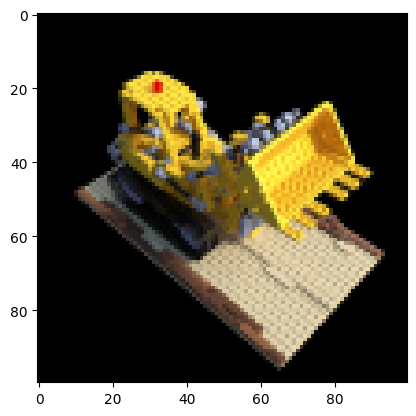

In [4]:

data = np.load("lego_data.npz")


images = data["images"]


height, width = images.shape[1:3]


poses = data["poses"]
poses = torch.from_numpy(poses).to(device)


intrinsics = data["intrinsics"]
intrinsics = torch.from_numpy(intrinsics).to(device)


test_image, test_pose = images[101], poses[101]
test_image = torch.from_numpy(test_image).to(device)


images = torch.from_numpy(images[:100, ..., :3]).to(device)

plt.imshow(test_image.detach().cpu().numpy())
plt.show()

In [5]:
def get_rays(height, width, intrinsics, w_R_c, w_T_c):

    device = intrinsics.device
    ray_directions = torch.zeros((height, width, 3), device=device)  
    ray_origins = torch.zeros((height, width, 3), device=device)  

    coords = torch.stack(torch.meshgrid(torch.arange(height), torch.arange(width), indexing='xy'), -1).reshape((-1,2))
    coords = torch.concat((coords, torch.ones(coords.shape[0],1)), -1).to(device)
    
    rays = w_R_c @ torch.linalg.inv(intrinsics) @ coords.T
    
    
    rays = rays/torch.norm(rays, dim=0)
    rays_directions = rays.T.reshape((height,width,3))
    rays_origins = torch.broadcast_to(w_T_c.T, ((height, width,3)))
    
    

    return rays_origins, rays_directions

In [6]:
def stratified_sampling(ray_origins, ray_directions, near, far, samples):


    i = torch.arange(samples)
    depth = near + (i/samples)*(far-near)
    depth = depth.to(device)
    ray_points = torch.unsqueeze(ray_origins, dim=3) + torch.unsqueeze(ray_directions, dim = 3) * depth
    ray_points = ray_points.permute(0,1,3,2)
    depth_points = torch.broadcast_to(depth, (ray_origins.shape[0], ray_origins.shape[1], samples))

    return ray_points, depth_points

In [7]:
class nerf_model(nn.Module):


    def __init__(self, filter_size=256, num_x_frequencies=6, num_d_frequencies=3):
        super().__init__()



        self.layers = nn.ModuleDict({
            'layer_1': nn.Linear(3*2*num_x_frequencies + 3, filter_size),
            'layer_2': nn.Linear(filter_size,filter_size),
            'layer_3': nn.Linear(filter_size,filter_size),
            'layer_4': nn.Linear(filter_size,filter_size),
            'layer_5': nn.Linear(filter_size,filter_size),
            'layer_6': nn.Linear(filter_size+3*2*num_x_frequencies + 3, filter_size),
            'layer_7': nn.Linear(filter_size,filter_size),
            'layer_8': nn.Linear(filter_size,filter_size),
            'layer_s': nn.Linear(filter_size,1),
            'layer_9': nn.Linear(filter_size,filter_size),
            'layer_10': nn.Linear(filter_size+3*2*num_d_frequencies + 3,filter_size//2),
            'layer_11': nn.Linear(filter_size//2, 3),
        })



    def forward(self, x, d):

        out = self.layers['layer_1'](x)
        out = F.relu(out)
        out = self.layers['layer_2'](out)
        out = F.relu(out)
        out = self.layers['layer_3'](out)
        out = F.relu(out)
        out = self.layers['layer_4'](out)
        out = F.relu(out)
        out = self.layers['layer_5'](out)
        out = F.relu(out)
        out = torch.concat([x,out], -1)
        out = self.layers['layer_6'](out)
        out = F.relu(out)
        out = self.layers['layer_7'](out)
        out = F.relu(out)
        out = self.layers['layer_8'](out)
        sigma = self.layers['layer_s'](out)
        sigma = F.relu(sigma)
        out = self.layers['layer_9'](out)
        out = F.relu(out)
        out = torch.concat([out, d], -1)
        out = self.layers['layer_10'](out)
        out = F.relu(out)
        out = self.layers['layer_11'](out)
        rgb = F.sigmoid(out)


        return rgb, sigma

In [8]:
def get_batches(ray_points, ray_directions, num_x_frequencies, num_d_frequencies):

    def get_chunks(inputs, chunksize = 2**15):
       
        return [inputs[i:i + chunksize] for i in range(0, inputs.shape[0], chunksize)]


    ray_directions = torch.unsqueeze(ray_directions, dim=2)
    ray_directions = torch.broadcast_to(ray_directions, ray_points.shape)
    
    
    embed_ray_dir = positional_encoding(ray_directions.reshape((-1,3)), num_frequencies=num_d_frequencies, incl_input=True)
    embed_ray_point = positional_encoding(ray_points.reshape((-1,3)), num_frequencies=num_x_frequencies, incl_input=True)
    ray_points_batches = get_chunks(embed_ray_point)
    ray_directions_batches = get_chunks(embed_ray_dir)
    
    
    
    


    return ray_points_batches, ray_directions_batches

In [9]:
def volumetric_rendering(rgb, s, depth_points):



    delta = depth_points[...,1:]  - depth_points[...,:-1]
    delta = torch.concat([delta, torch.ones((delta.shape[0], delta.shape[1], 1)).to(device)*1e9], -1) 
    inter_Ti = torch.exp(-s*delta)
    Ti = torch.concat([torch.ones((delta.shape[0], delta.shape[1], 1)).to(device),torch.cumprod(inter_Ti, dim=-1)[:,:,:-1]], -1)

    c = torch.unsqueeze(Ti, dim=-1) * (1-torch.unsqueeze(inter_Ti, dim=-1)) * rgb
    rec_image = torch.sum(c, dim=2)


    return rec_image

In [10]:
def one_forward_pass(height, width, intrinsics, w_R_c, w_T_c, near, far, samples, model, num_x_frequencies, num_d_frequencies):



    

    
    
    
    
    ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c.reshape((3,3)), w_T_c.reshape((3,1)))

    
    ray_points, depth_points = stratified_sampling(ray_o, ray_d, near, far, samples)

    
    ray_points_batches, ray_directions_batches = get_batches(ray_points, ray_d, num_x_frequencies, num_d_frequencies)
    rgb_list = []
    sigma_list =[]
    
    for batch_i in range(len(ray_points_batches)):
      
      rgb, sigma = model(ray_points_batches[batch_i], ray_directions_batches[batch_i])
      rgb_list.append(rgb)
      sigma_list.append(sigma)
      
    rec_image = volumetric_rendering(torch.concat(rgb_list, 0).reshape((height, width,samples, 3)), torch.concat(sigma_list,0).reshape((height, width, samples)), depth_points)
 

    return rec_image

In [11]:
num_x_frequencies = 10
num_d_frequencies = 4
learning_rate  = 5e-4
iterations = 3000
samples = 64
display = 25
near = 0.667
far = 2

model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)

def weights_init(m):
    if isinstance(m, torch.nn.Linear):
        torch.nn.init.xavier_uniform_(m.weight)
model.apply(weights_init)

optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

psnrs = []
iternums = []

t = time.time()
t0 = time.time()

In [12]:
criterion = torch.nn.MSELoss()

In [13]:
poses = torch.Tensor(poses)
poses.shape

torch.Size([106, 4, 4])

In [14]:
w_T_c_all = poses[:,:3,-1]
w_T_c_all.shape

torch.Size([106, 3])

In [15]:
w_R_c_all = poses[:,:3,:3]
w_R_c_all.shape

torch.Size([106, 3, 3])

In [ ]:
torch.Tensor([[1,0,0],[0,1,0], [0,0,1]]).shape

In [16]:
angle_noise = 1 
r =  Rotation.from_euler('xyz', np.random.randn(3)*angle_noise, degrees=False)
rot_d = torch.from_numpy(r.as_matrix()).float().to(device)
w_R_c_all_perturb = torch.zeros_like(w_R_c_all)
for i in range(w_R_c_all_perturb.shape[0]):
    w_R_c_all_perturb[i,...] = rot_d @ w_R_c_all[i,...]
w_R_c_all_perturb[0].shape, w_R_c_all_perturb[0]

(torch.Size([3, 3]),
 tensor([[ 0.1421, -0.7892,  0.5975],
         [-0.2325, -0.6133, -0.7548],
         [ 0.9622, -0.0316, -0.2706]], device='cuda:0'))

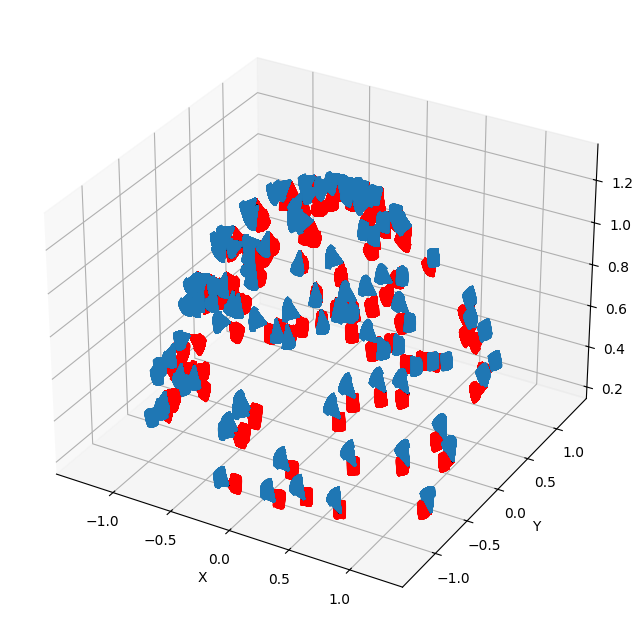

In [17]:
def plot_all_poses(poses, w_R_c_all_perturb, w_T_c_all):


    poses = torch.Tensor(poses).to(device)
    
    w_R_c = poses[:,:3,:3]
    w_T_c = poses[:,:3,3]
    origins = torch.zeros((poses.shape[0],height, width, 3))
    directions = torch.zeros((poses.shape[0],height, width, 3))
    for i in range(poses.shape[0]):
      ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c[i,...].reshape((3,3)), w_T_c[i,...].reshape((3,1)))
      origins[i] = ray_o.to('cpu')
      directions[i] = ray_d.to('cpu')
      
      
    


    ax = plt.figure(figsize=(12, 8)).add_subplot(projection='3d')
    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True, color='red')
    
    w_R_c = w_R_c_all_perturb
    w_T_c = w_T_c_all
    origins = torch.zeros((poses.shape[0],height, width, 3))
    directions = torch.zeros((poses.shape[0],height, width, 3))
    for i in range(poses.shape[0]):
      ray_o, ray_d = get_rays(height, width, intrinsics, w_R_c[i,...].reshape((3,3)), w_T_c[i,...].reshape((3,1)))
      origins[i] = ray_o.to('cpu')
      directions[i] = ray_d.to('cpu')
      
      
    


    _ = ax.quiver(origins[..., 0].flatten(),
                  origins[..., 1].flatten(),
                  origins[..., 2].flatten(),
                  directions[..., 0].flatten(),
                  directions[..., 1].flatten(),
                  directions[..., 2].flatten(), length=0.12, normalize=True)
  
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('z')
    plt.show()

plot_all_poses(data['poses'], w_R_c_all_perturb, w_T_c_all)

In [18]:
w_R_c_all_perturb.shape

torch.Size([106, 3, 3])

In [19]:

test_pose_w_R_c = test_pose[:3,:3]
test_pose_w_T_c = test_pose[:3, 3]
lr_rotation=0.01

In [20]:
mse_euler_error_list = []
loss_list = []
psnr_list = []

In [21]:
running_mse_euler_error = 0
running_loss = 0
running_psnr = 0

Iteration 0  Loss: 0.1939  PSNR: 7.12  Time: 11.89 secs per iter,  4.95 mins in total
The rotation error as compared to GT Rotation : 0.5511198043823242


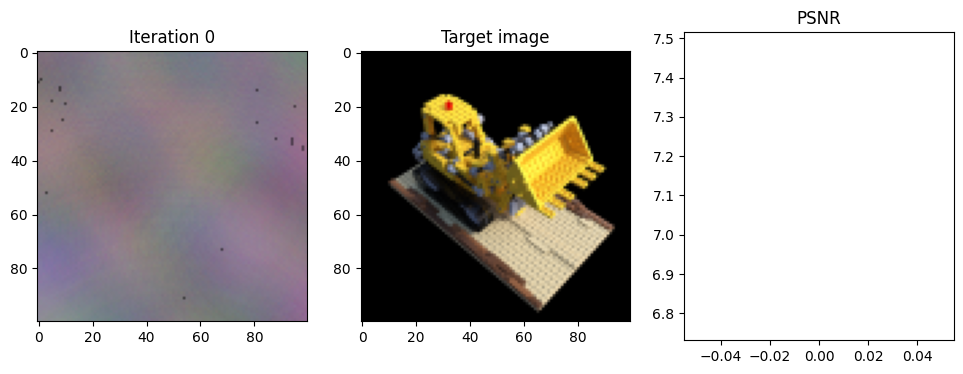

Iteration 25  Loss: 0.0861  PSNR: 10.65  Time: 0.33 secs per iter,  5.09 mins in total
The rotation error as compared to GT Rotation : 0.5731849122047424


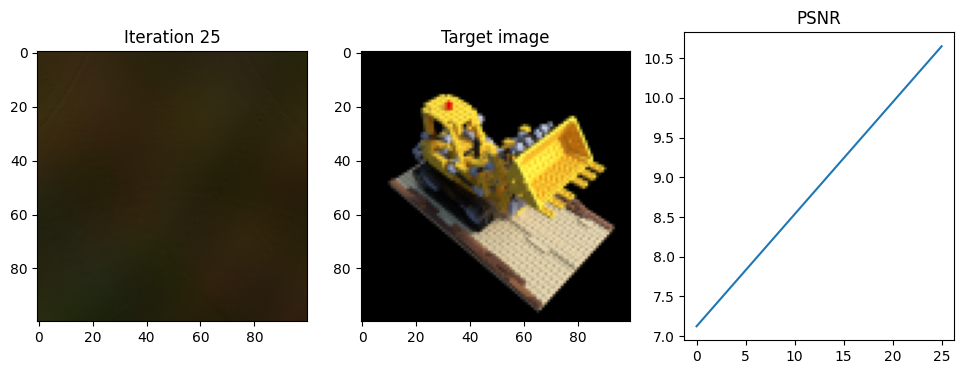

Iteration 50  Loss: 0.0866  PSNR: 10.62  Time: 0.33 secs per iter,  5.23 mins in total
The rotation error as compared to GT Rotation : 0.5511492848396301


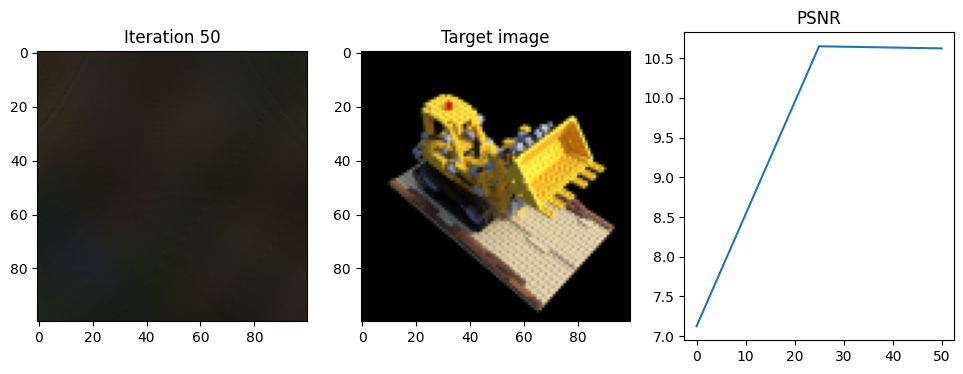

Iteration 75  Loss: 0.0883  PSNR: 10.54  Time: 0.33 secs per iter,  5.37 mins in total
The rotation error as compared to GT Rotation : 0.551139440536499


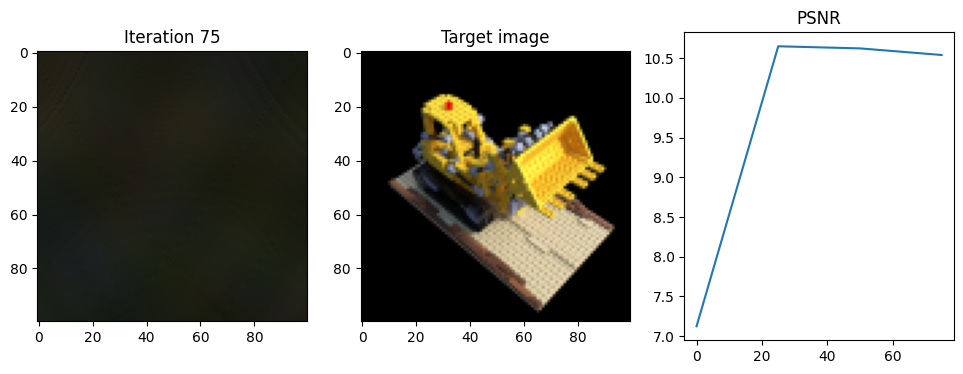

Iteration 100  Loss: 0.0888  PSNR: 10.52  Time: 0.33 secs per iter,  5.51 mins in total
The rotation error as compared to GT Rotation : 0.5511485409736633


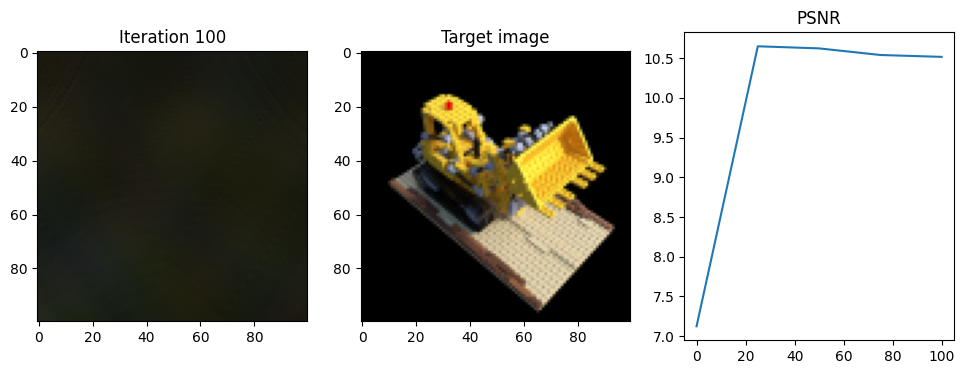

Iteration 125  Loss: 0.0873  PSNR: 10.59  Time: 0.33 secs per iter,  5.65 mins in total
The rotation error as compared to GT Rotation : 0.5511247944831849


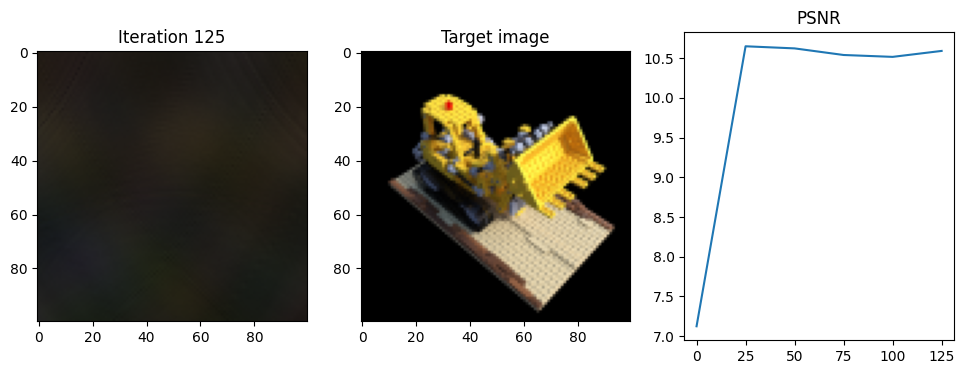

Iteration 150  Loss: 0.0923  PSNR: 10.35  Time: 0.33 secs per iter,  5.79 mins in total
The rotation error as compared to GT Rotation : 0.55109139919281


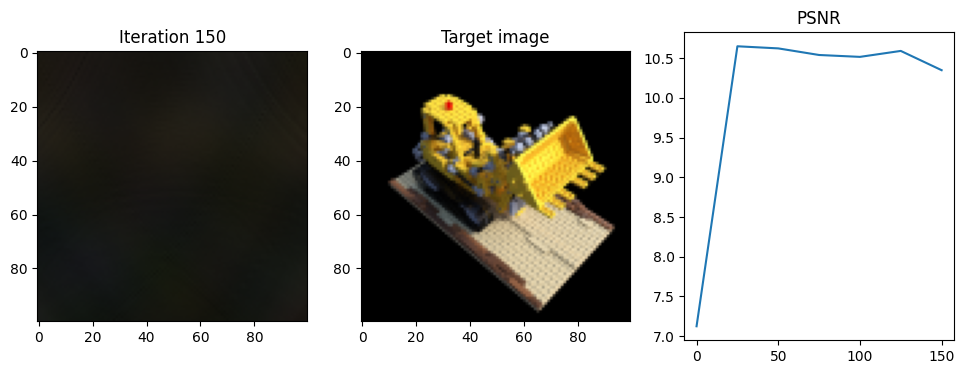

Iteration 175  Loss: 0.0872  PSNR: 10.60  Time: 0.33 secs per iter,  5.92 mins in total
The rotation error as compared to GT Rotation : 0.5511078405380249


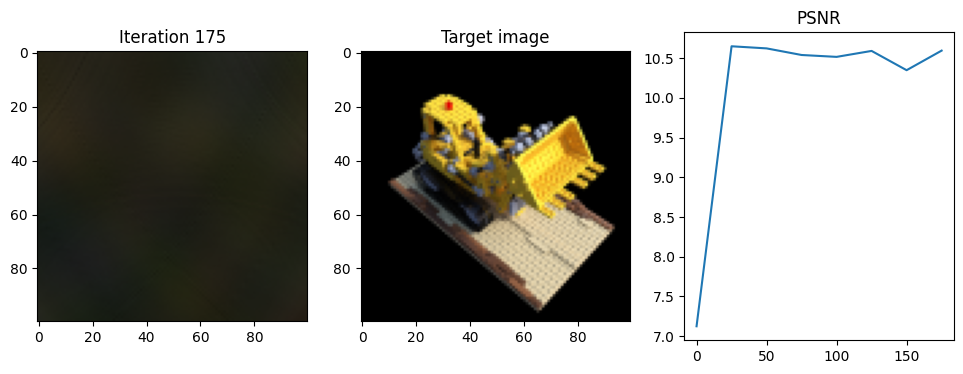

Iteration 200  Loss: 0.0901  PSNR: 10.45  Time: 0.33 secs per iter,  6.06 mins in total
The rotation error as compared to GT Rotation : 0.5511248469352722


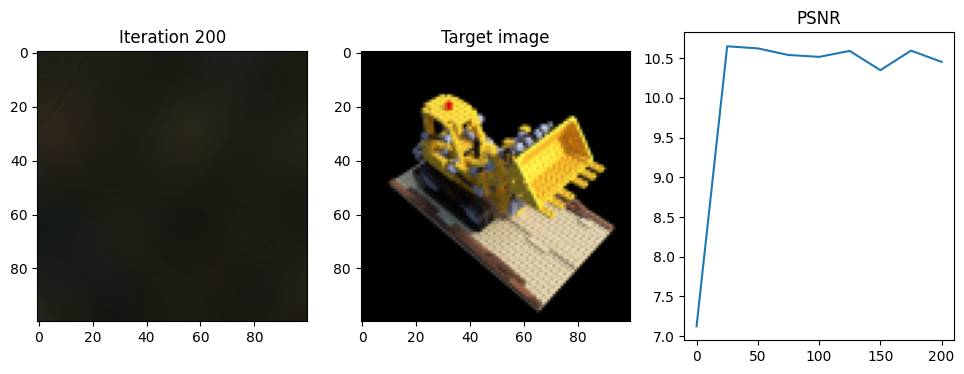

Iteration 225  Loss: 0.0946  PSNR: 10.24  Time: 0.33 secs per iter,  6.20 mins in total
The rotation error as compared to GT Rotation : 0.5510965800285339


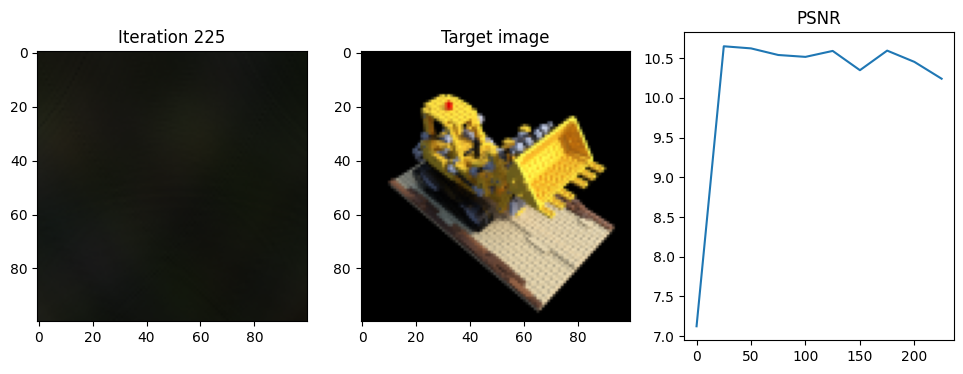

Iteration 250  Loss: 0.0931  PSNR: 10.31  Time: 0.33 secs per iter,  6.34 mins in total
The rotation error as compared to GT Rotation : 0.5511050915718079


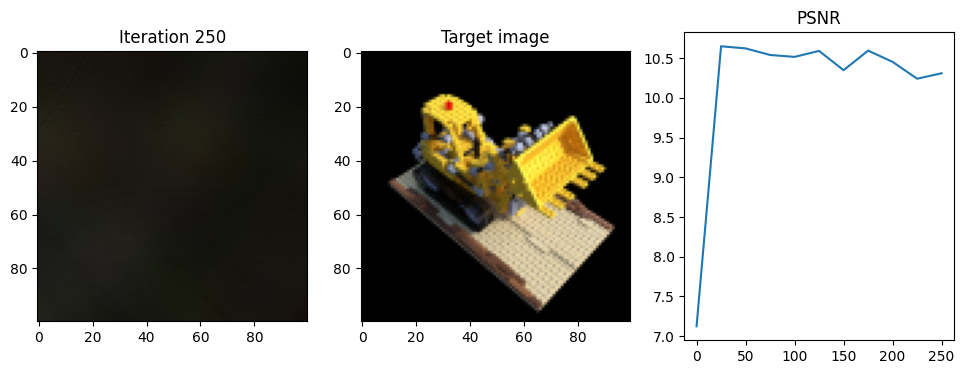

Iteration 275  Loss: 0.0905  PSNR: 10.43  Time: 0.33 secs per iter,  6.48 mins in total
The rotation error as compared to GT Rotation : 0.5511358618736267


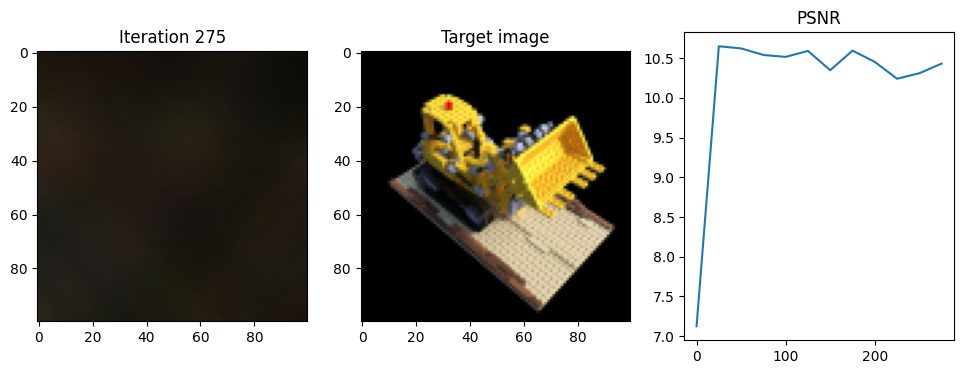

Iteration 300  Loss: 0.0894  PSNR: 10.49  Time: 0.33 secs per iter,  6.62 mins in total
The rotation error as compared to GT Rotation : 0.5511410760879517


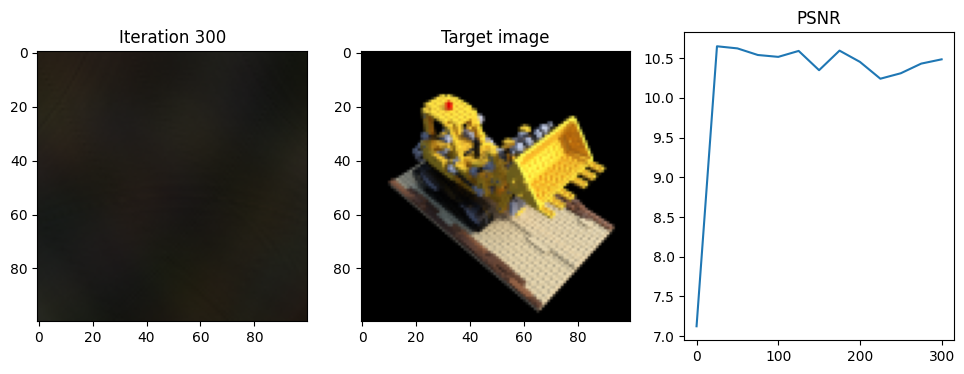

Iteration 325  Loss: 0.0904  PSNR: 10.44  Time: 0.33 secs per iter,  6.75 mins in total
The rotation error as compared to GT Rotation : 0.5511830186843872


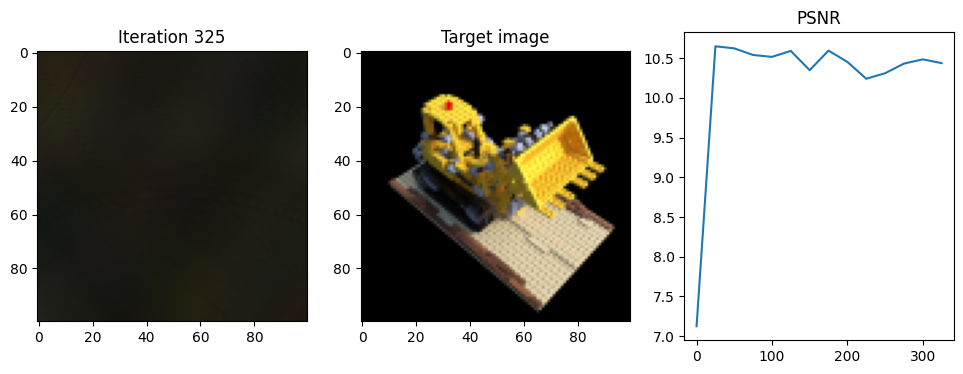

Iteration 350  Loss: 0.0899  PSNR: 10.46  Time: 0.33 secs per iter,  6.89 mins in total
The rotation error as compared to GT Rotation : 0.5512027716636658


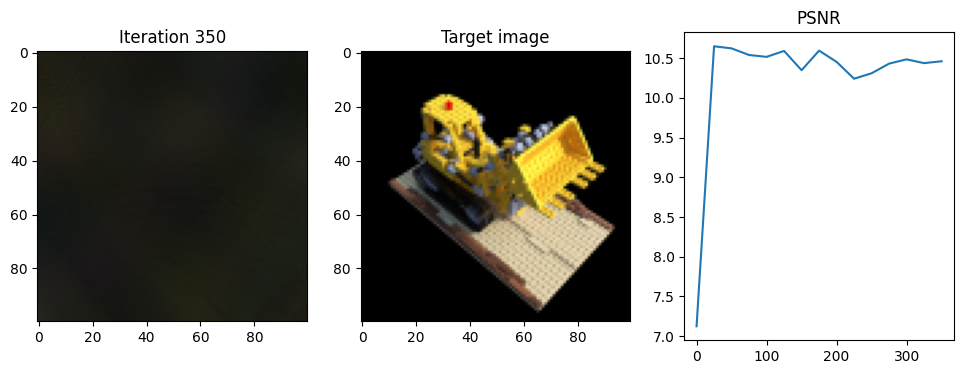

Iteration 375  Loss: 0.0936  PSNR: 10.29  Time: 0.33 secs per iter,  7.03 mins in total
The rotation error as compared to GT Rotation : 0.5511870908737183


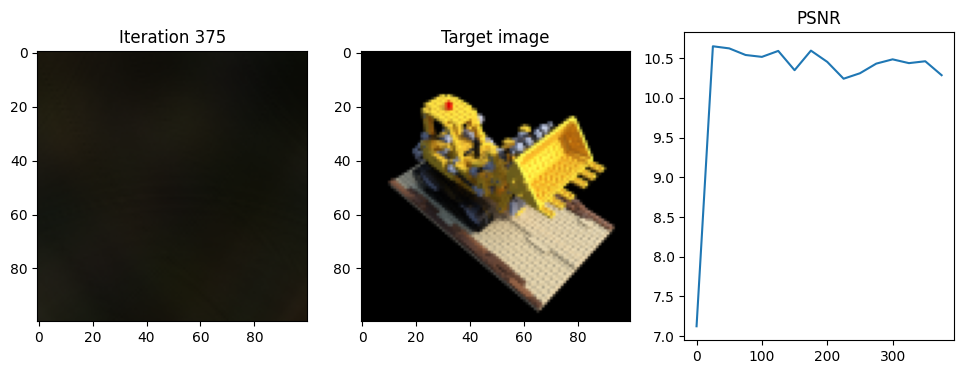

Iteration 400  Loss: 0.0910  PSNR: 10.41  Time: 0.33 secs per iter,  7.17 mins in total
The rotation error as compared to GT Rotation : 0.5511512470245361


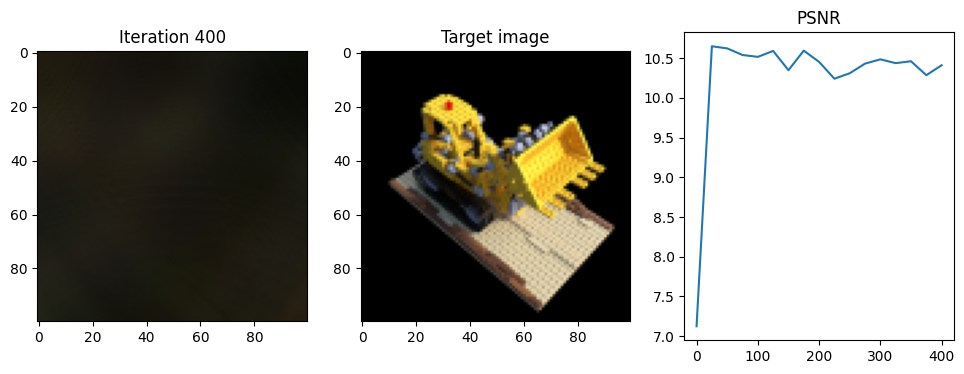

Iteration 425  Loss: 0.0946  PSNR: 10.24  Time: 0.33 secs per iter,  7.31 mins in total
The rotation error as compared to GT Rotation : 0.551172788143158


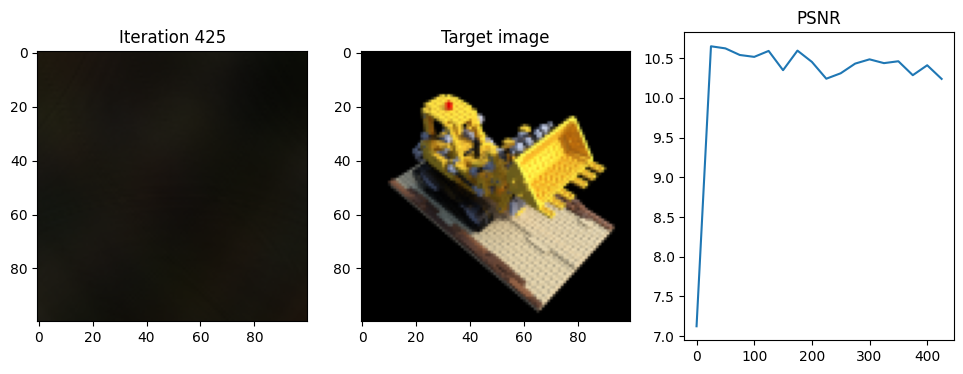

Iteration 450  Loss: 0.0899  PSNR: 10.46  Time: 0.33 secs per iter,  7.44 mins in total
The rotation error as compared to GT Rotation : 0.5511786198616028


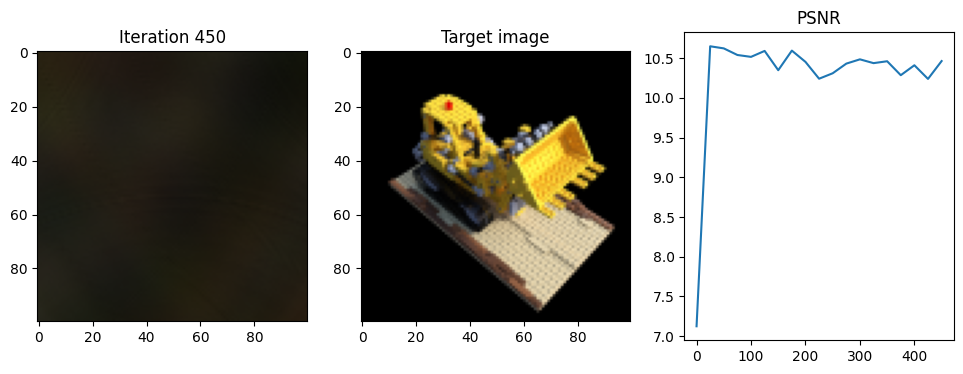

Iteration 475  Loss: 0.0979  PSNR: 10.09  Time: 0.33 secs per iter,  7.58 mins in total
The rotation error as compared to GT Rotation : 0.5511152863502502


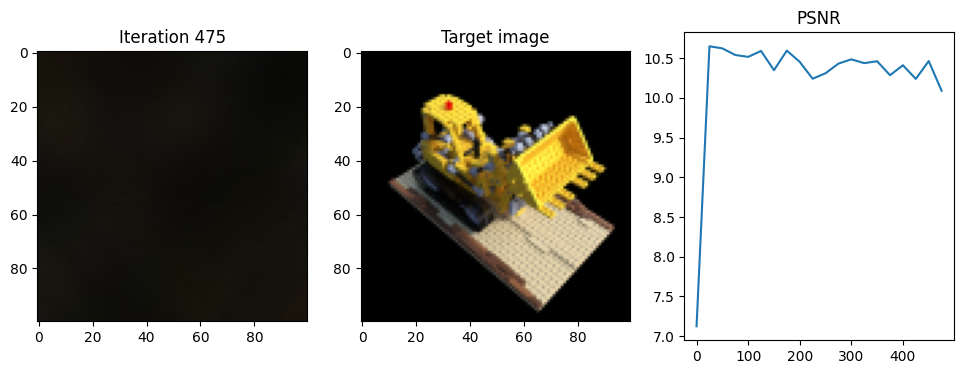

Iteration 500  Loss: 0.0883  PSNR: 10.54  Time: 0.33 secs per iter,  7.72 mins in total
The rotation error as compared to GT Rotation : 0.5511347627639771


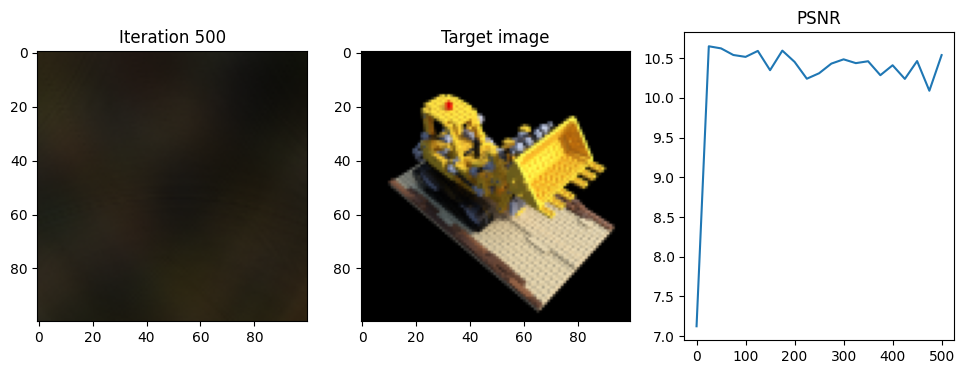

Iteration 525  Loss: 0.0972  PSNR: 10.12  Time: 0.42 secs per iter,  7.90 mins in total
The rotation error as compared to GT Rotation : 0.5511038708686828


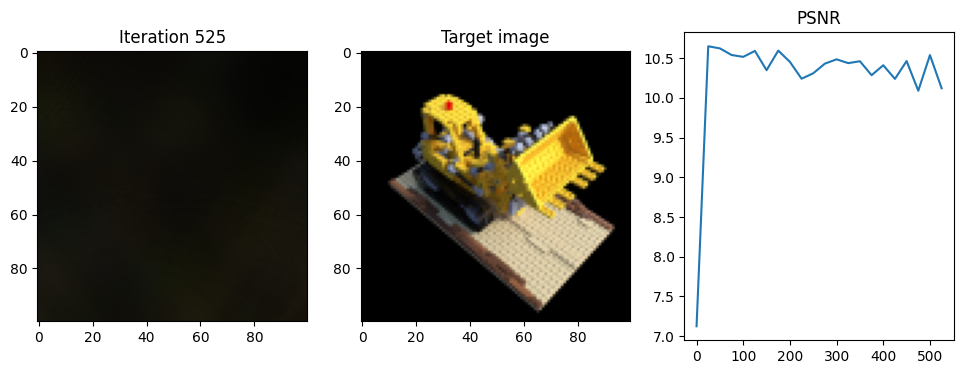

Iteration 550  Loss: 0.0855  PSNR: 10.68  Time: 0.33 secs per iter,  8.04 mins in total
The rotation error as compared to GT Rotation : 0.5511557650566101


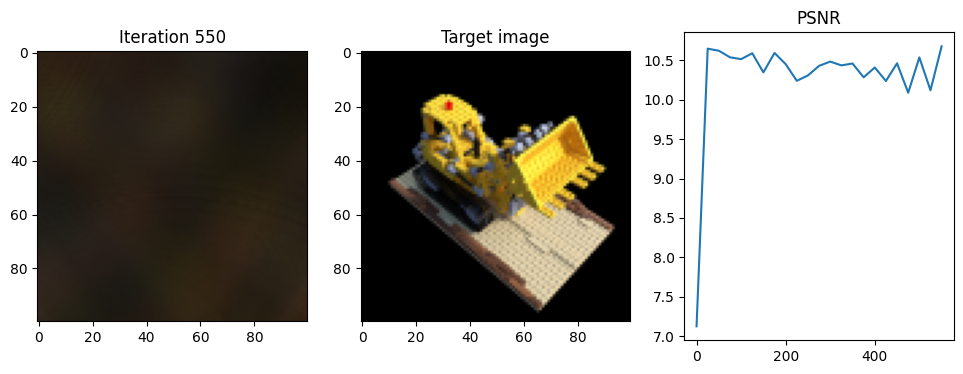

Iteration 575  Loss: 0.0993  PSNR: 10.03  Time: 0.33 secs per iter,  8.17 mins in total
The rotation error as compared to GT Rotation : 0.5510479712486267


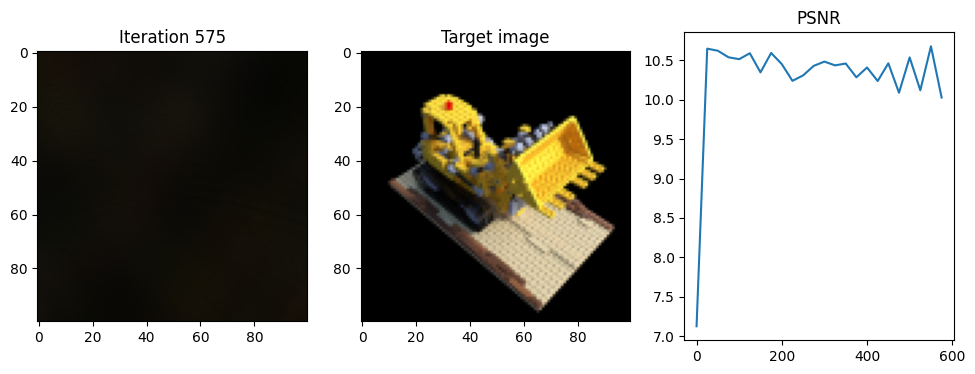

Iteration 600  Loss: 0.0960  PSNR: 10.18  Time: 0.33 secs per iter,  8.31 mins in total
The rotation error as compared to GT Rotation : 0.5509189438819885


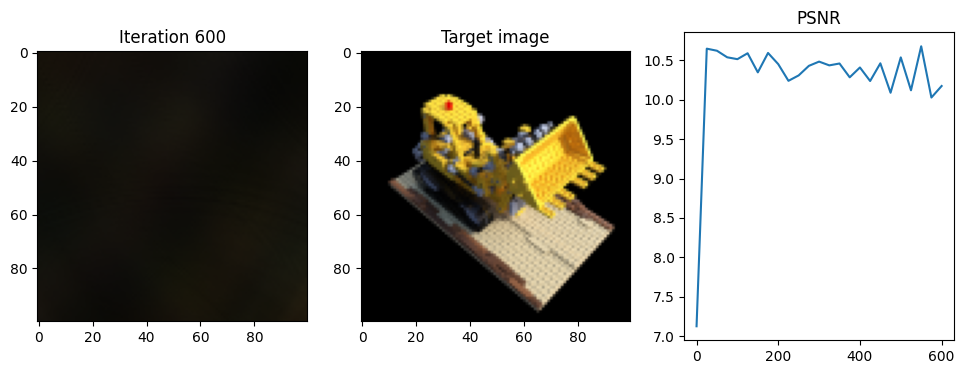

Iteration 625  Loss: 0.0930  PSNR: 10.32  Time: 0.33 secs per iter,  8.45 mins in total
The rotation error as compared to GT Rotation : 0.5509368467330933


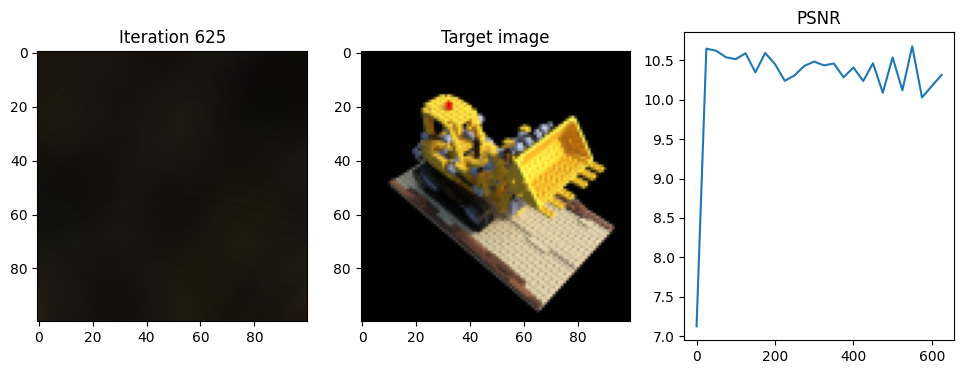

Iteration 650  Loss: 0.0959  PSNR: 10.18  Time: 0.33 secs per iter,  8.59 mins in total
The rotation error as compared to GT Rotation : 0.55095538854599


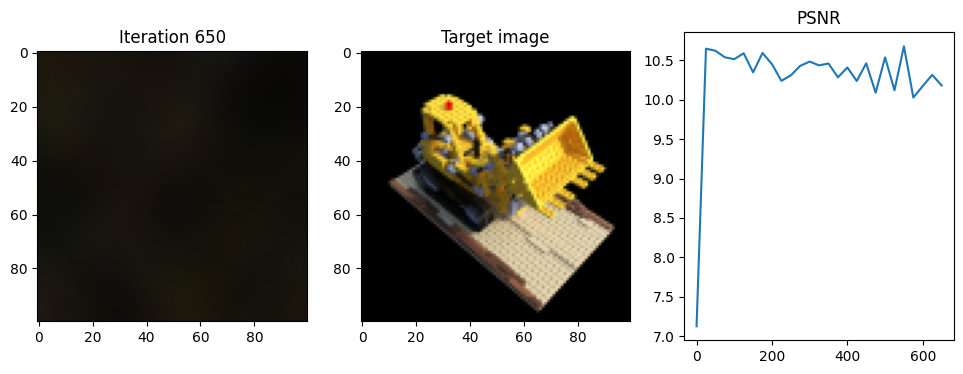

Iteration 675  Loss: 0.0933  PSNR: 10.30  Time: 0.33 secs per iter,  8.73 mins in total
The rotation error as compared to GT Rotation : 0.550920147895813


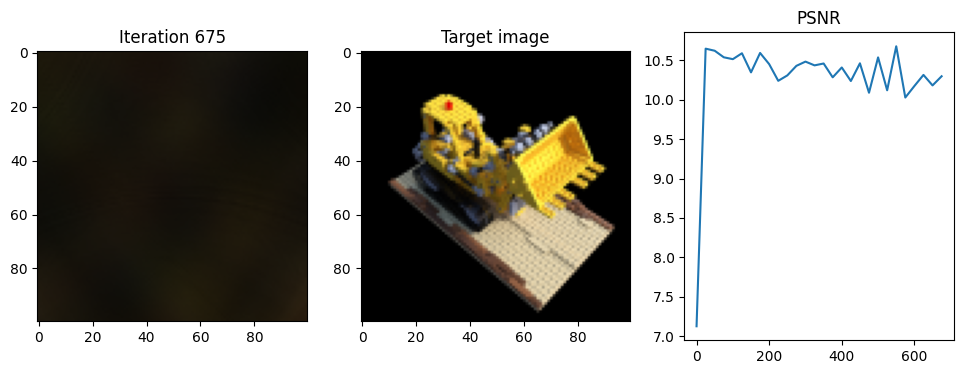

Iteration 700  Loss: 0.0952  PSNR: 10.21  Time: 0.34 secs per iter,  8.87 mins in total
The rotation error as compared to GT Rotation : 0.55090402841568


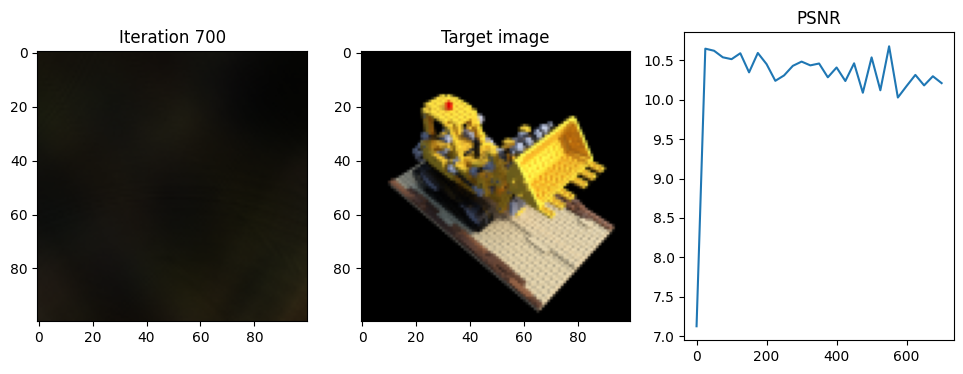

Iteration 725  Loss: 0.1000  PSNR: 10.00  Time: 0.33 secs per iter,  9.00 mins in total
The rotation error as compared to GT Rotation : 0.5509073162078857


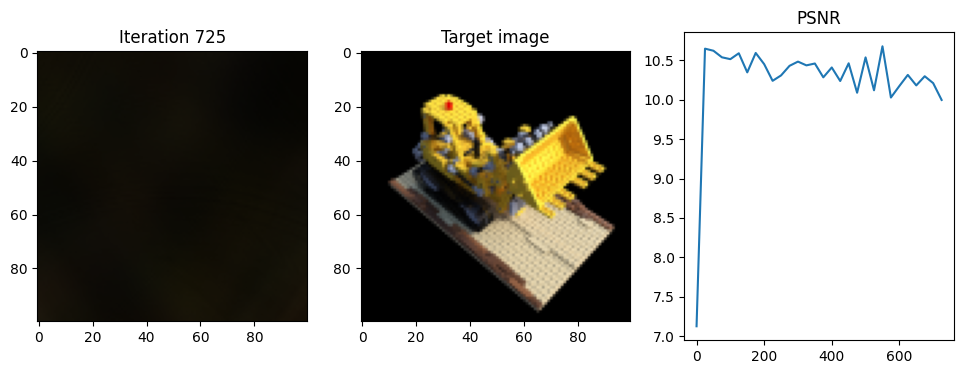

Iteration 750  Loss: 0.0983  PSNR: 10.07  Time: 0.33 secs per iter,  9.14 mins in total
The rotation error as compared to GT Rotation : 0.5508733677864075


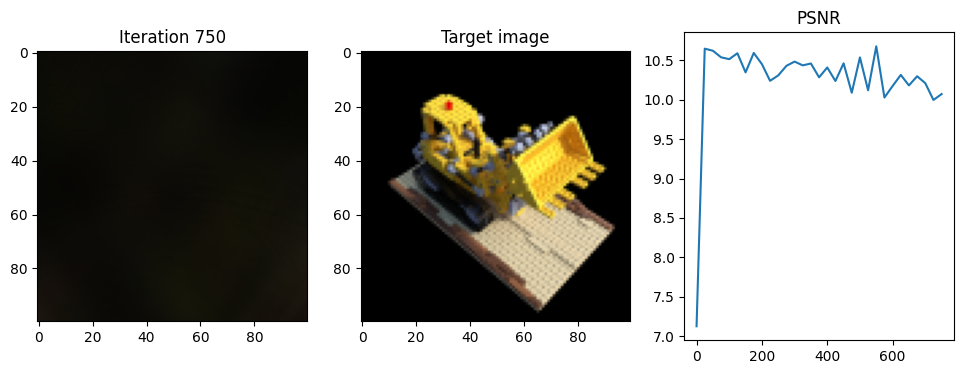

Iteration 775  Loss: 0.1045  PSNR: 9.81  Time: 0.33 secs per iter,  9.28 mins in total
The rotation error as compared to GT Rotation : 0.5507861208915711


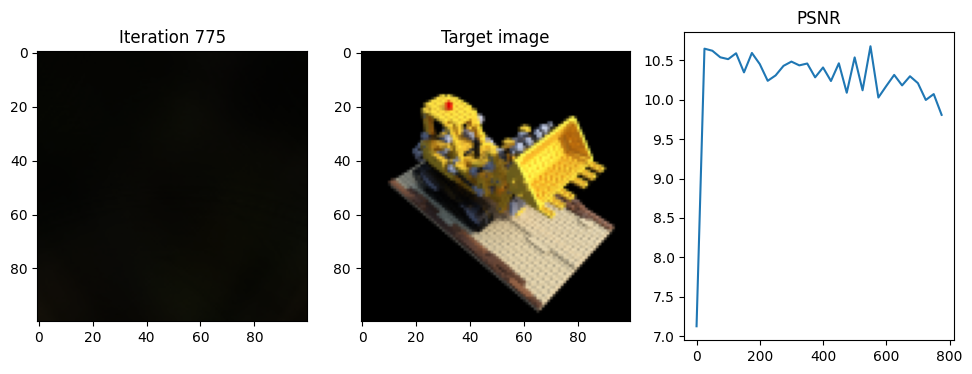

Iteration 800  Loss: 0.1008  PSNR: 9.97  Time: 0.33 secs per iter,  9.42 mins in total
The rotation error as compared to GT Rotation : 0.5506789541244507


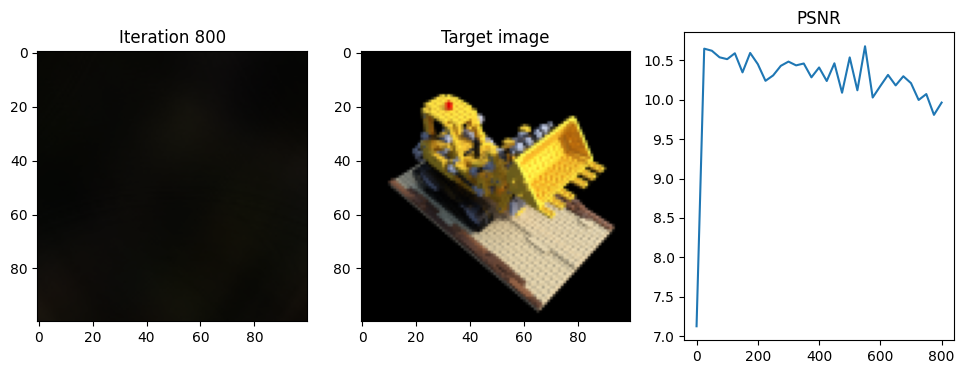

Iteration 825  Loss: 0.0957  PSNR: 10.19  Time: 0.33 secs per iter,  9.56 mins in total
The rotation error as compared to GT Rotation : 0.5506844449043274


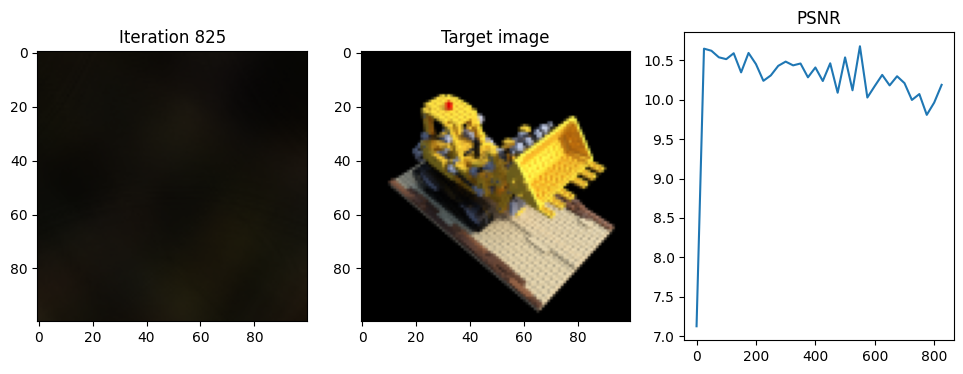

Iteration 850  Loss: 0.0990  PSNR: 10.04  Time: 0.33 secs per iter,  9.69 mins in total
The rotation error as compared to GT Rotation : 0.5507312226295471


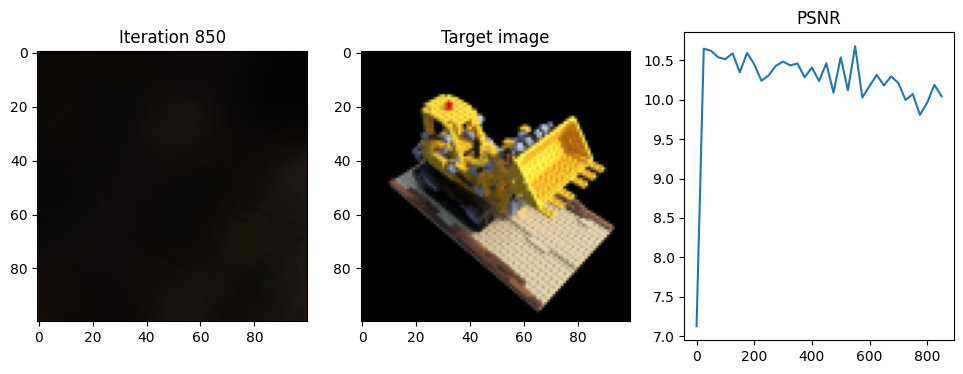

Iteration 875  Loss: 0.1039  PSNR: 9.83  Time: 0.33 secs per iter,  9.83 mins in total
The rotation error as compared to GT Rotation : 0.5507456493377686


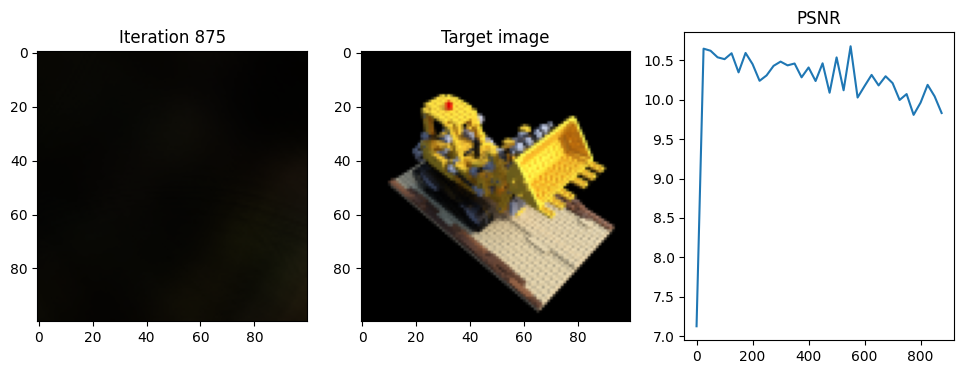

Iteration 900  Loss: 0.1011  PSNR: 9.95  Time: 0.34 secs per iter,  9.97 mins in total
The rotation error as compared to GT Rotation : 0.5507520580291748


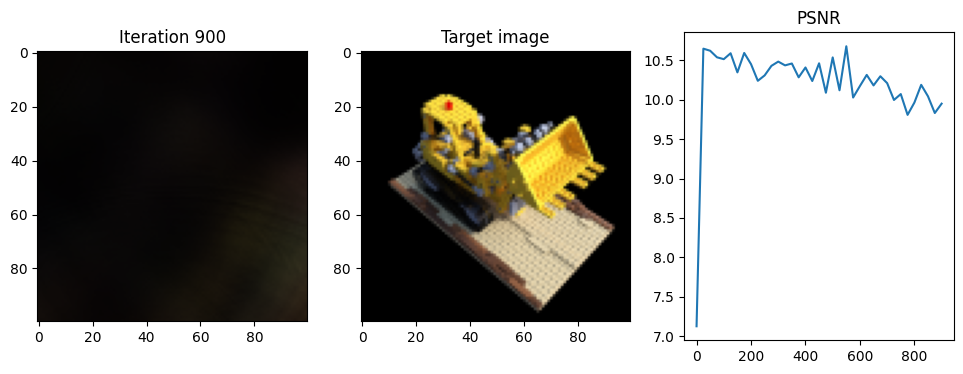

Iteration 925  Loss: 0.1034  PSNR: 9.85  Time: 0.33 secs per iter,  10.11 mins in total
The rotation error as compared to GT Rotation : 0.5507901048660279


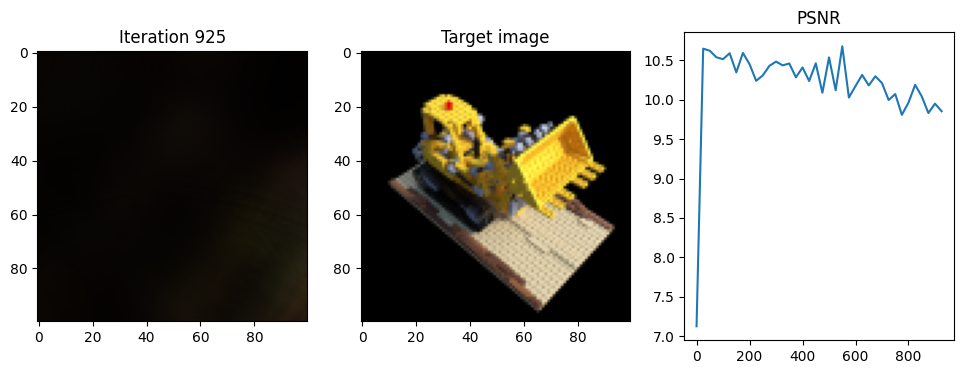

Iteration 950  Loss: 0.1067  PSNR: 9.72  Time: 0.33 secs per iter,  10.25 mins in total
The rotation error as compared to GT Rotation : 0.5506500744819641


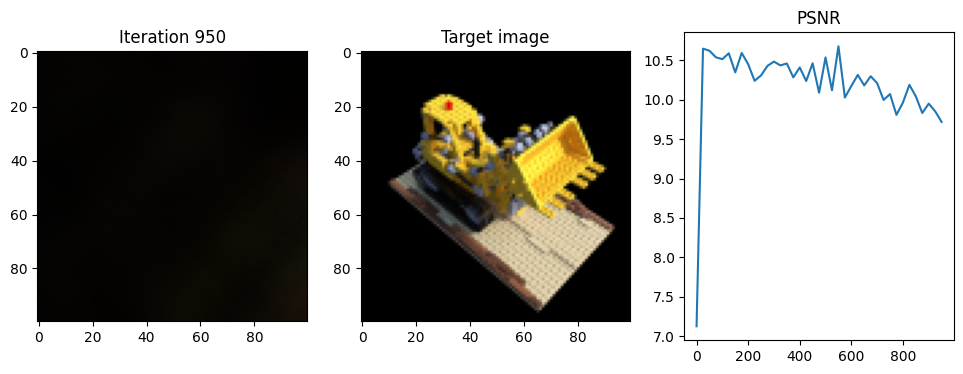

Iteration 975  Loss: 0.0971  PSNR: 10.13  Time: 0.33 secs per iter,  10.39 mins in total
The rotation error as compared to GT Rotation : 0.5506686210632324


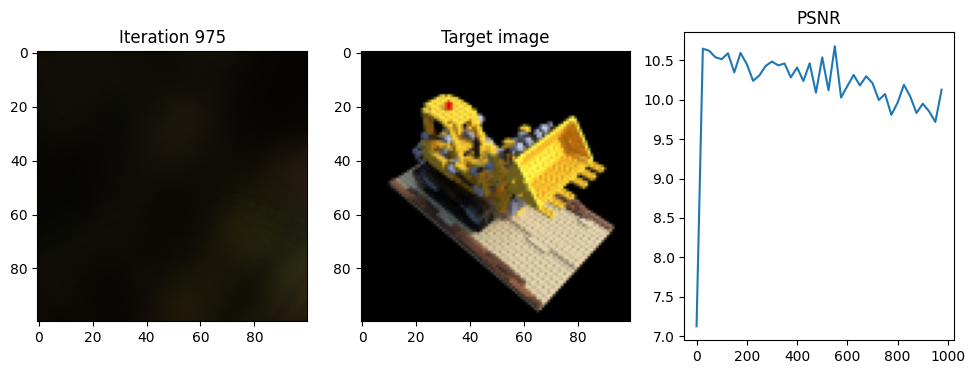

Iteration 1000  Loss: 0.1043  PSNR: 9.82  Time: 0.33 secs per iter,  10.52 mins in total
The rotation error as compared to GT Rotation : 0.5506955599784851


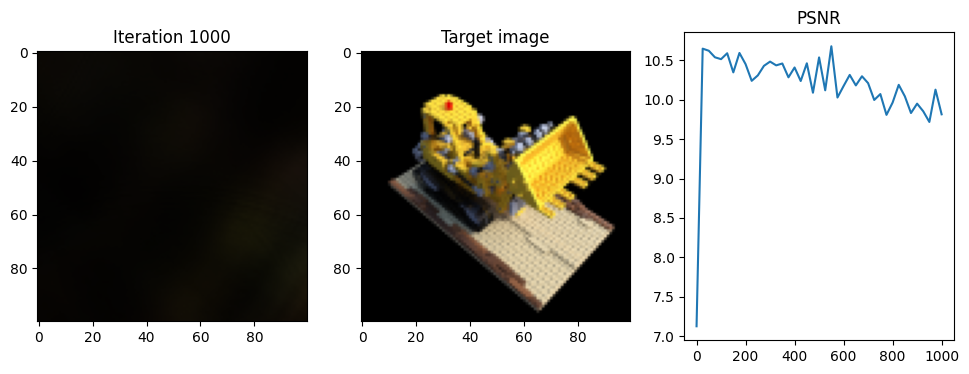

Iteration 1025  Loss: 0.1055  PSNR: 9.77  Time: 0.33 secs per iter,  10.66 mins in total
The rotation error as compared to GT Rotation : 0.5506918859481812


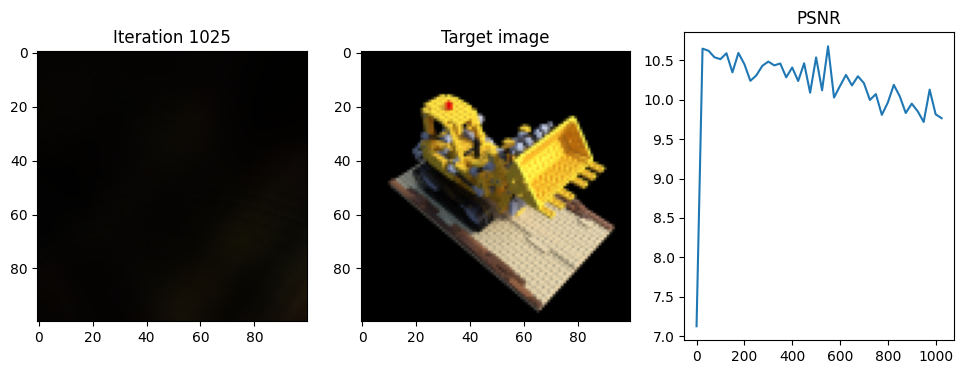

Iteration 1050  Loss: 0.1021  PSNR: 9.91  Time: 0.33 secs per iter,  10.80 mins in total
The rotation error as compared to GT Rotation : 0.550669903755188


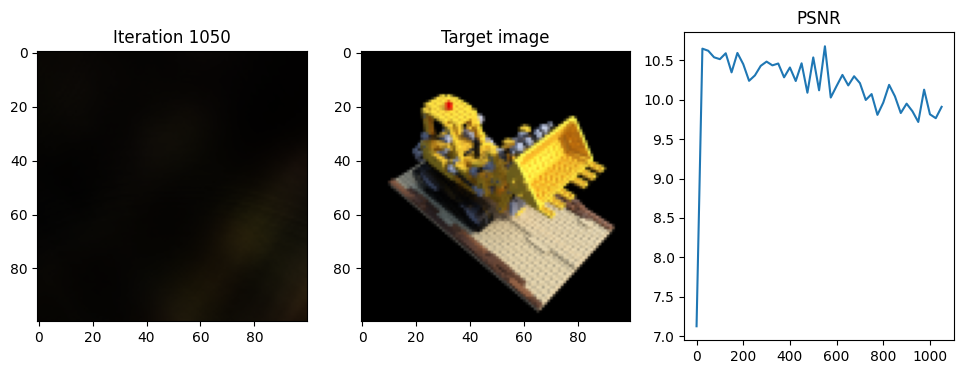

Iteration 1075  Loss: 0.1048  PSNR: 9.79  Time: 0.34 secs per iter,  10.94 mins in total
The rotation error as compared to GT Rotation : 0.5506086039543152


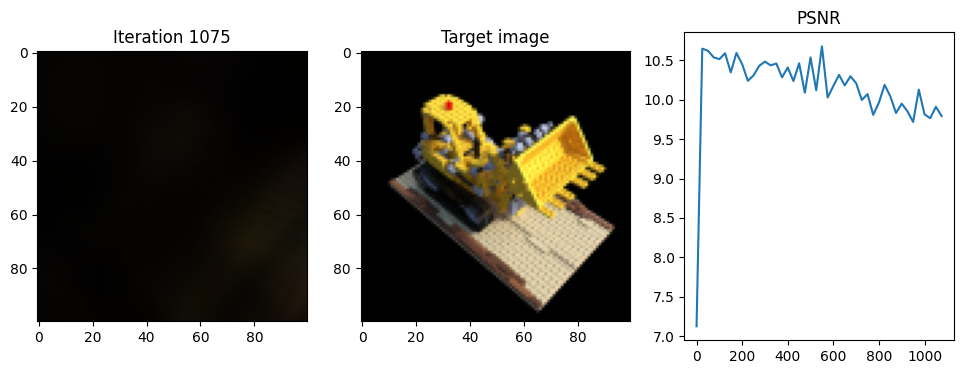

Iteration 1100  Loss: 0.1040  PSNR: 9.83  Time: 0.33 secs per iter,  11.08 mins in total
The rotation error as compared to GT Rotation : 0.5506157565116883


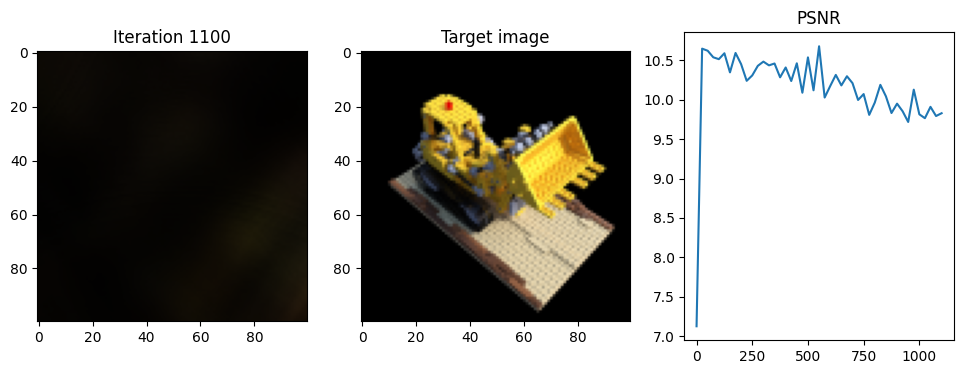

Iteration 1125  Loss: 0.1063  PSNR: 9.73  Time: 0.33 secs per iter,  11.22 mins in total
The rotation error as compared to GT Rotation : 0.5505511021614075


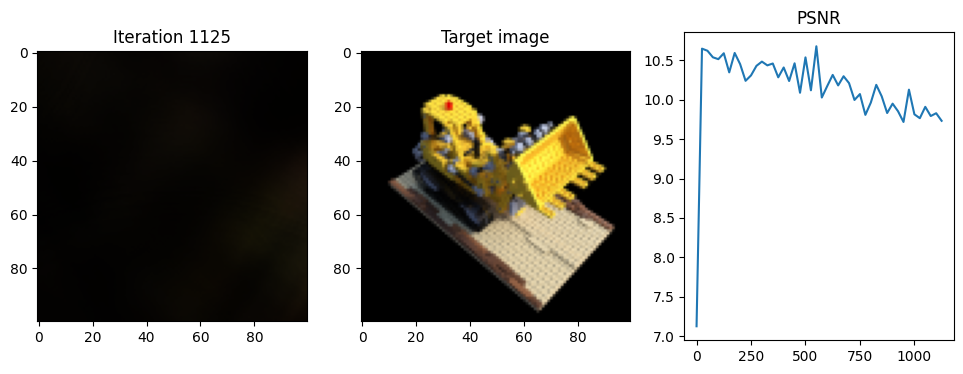

Iteration 1150  Loss: 0.0982  PSNR: 10.08  Time: 0.33 secs per iter,  11.35 mins in total
The rotation error as compared to GT Rotation : 0.550618839263916


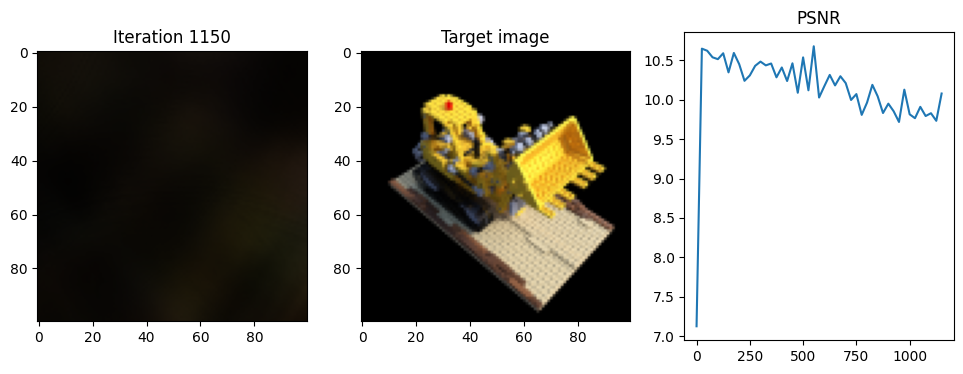

Iteration 1175  Loss: 0.0946  PSNR: 10.24  Time: 0.33 secs per iter,  11.49 mins in total
The rotation error as compared to GT Rotation : 0.5505666160583496


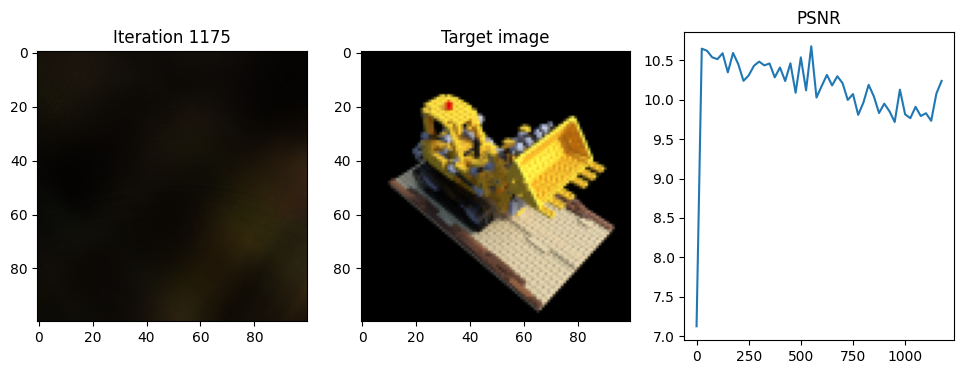

Iteration 1200  Loss: 0.1034  PSNR: 9.85  Time: 0.33 secs per iter,  11.63 mins in total
The rotation error as compared to GT Rotation : 0.5504595875740051


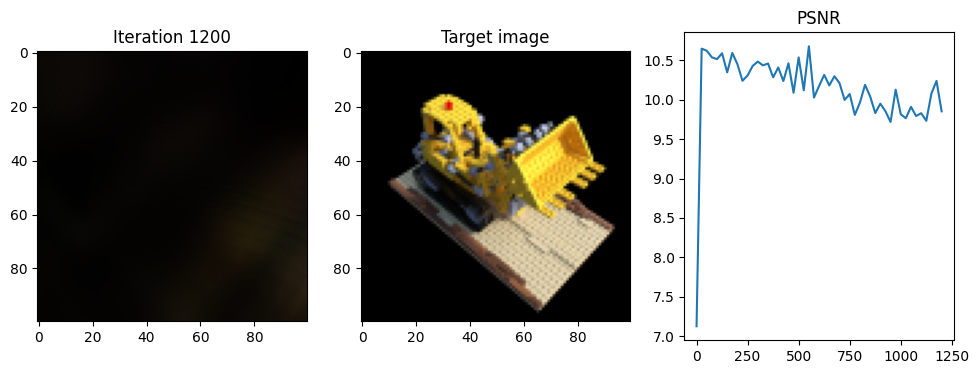

Iteration 1225  Loss: 0.1010  PSNR: 9.96  Time: 0.33 secs per iter,  11.77 mins in total
The rotation error as compared to GT Rotation : 0.5504449653625488


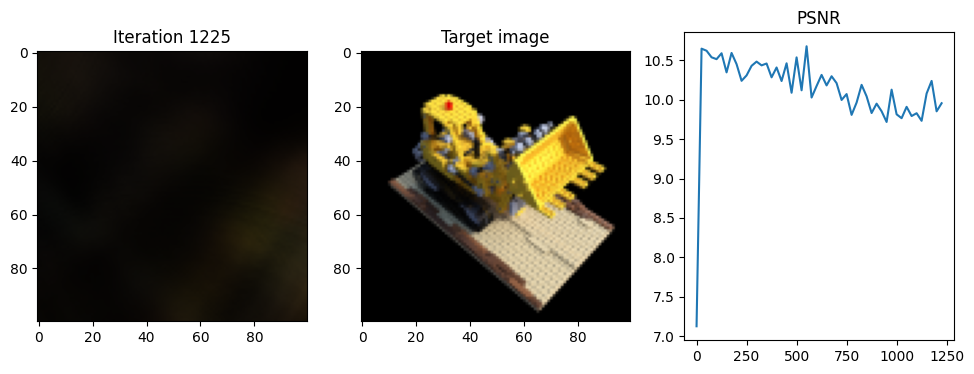

Iteration 1250  Loss: 0.0913  PSNR: 10.39  Time: 0.33 secs per iter,  11.91 mins in total
The rotation error as compared to GT Rotation : 0.550517270565033


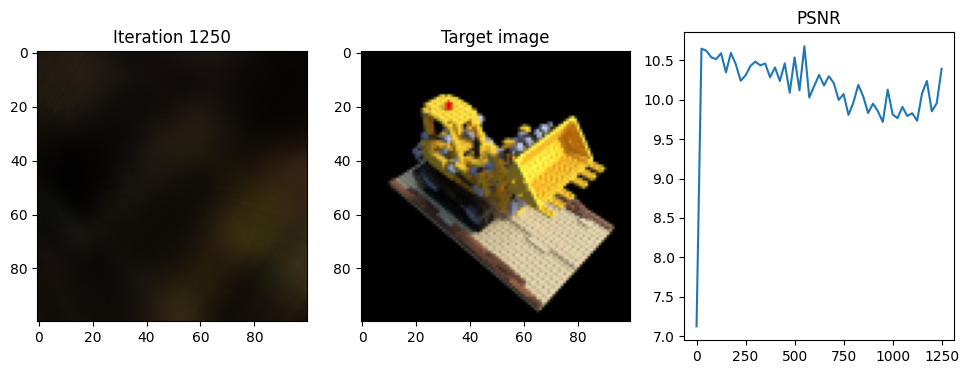

Iteration 1275  Loss: 0.0943  PSNR: 10.26  Time: 0.34 secs per iter,  12.05 mins in total
The rotation error as compared to GT Rotation : 0.5505293083190917


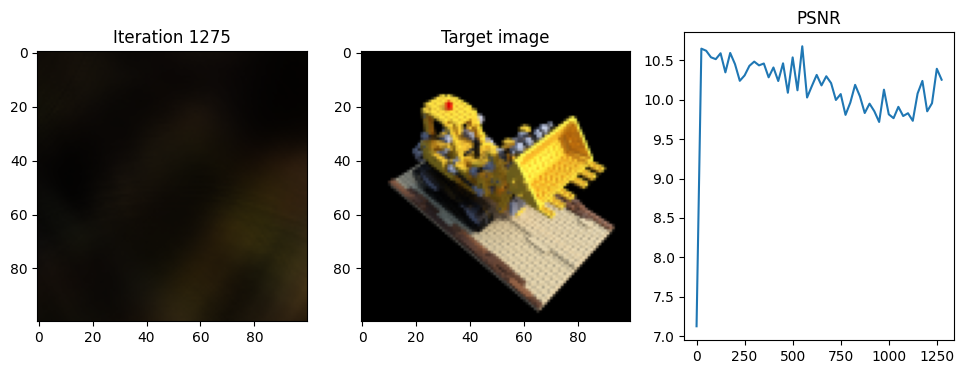

Iteration 1300  Loss: 0.1010  PSNR: 9.96  Time: 0.33 secs per iter,  12.19 mins in total
The rotation error as compared to GT Rotation : 0.5504834961891174


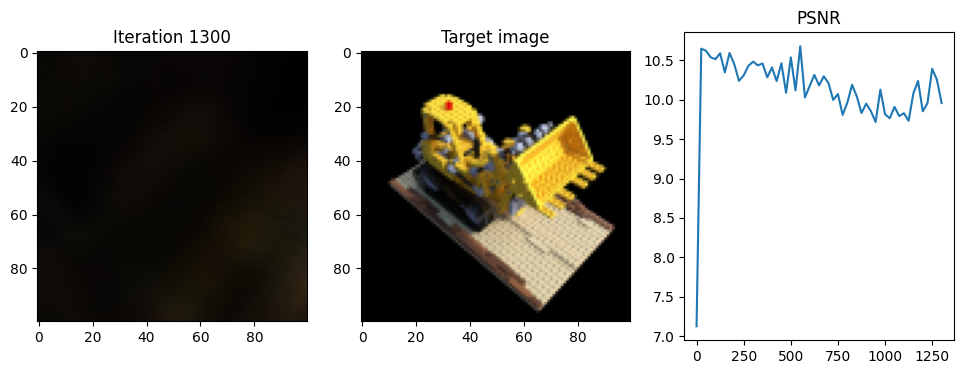

Iteration 1325  Loss: 0.1028  PSNR: 9.88  Time: 0.33 secs per iter,  12.32 mins in total
The rotation error as compared to GT Rotation : 0.5505261993408204


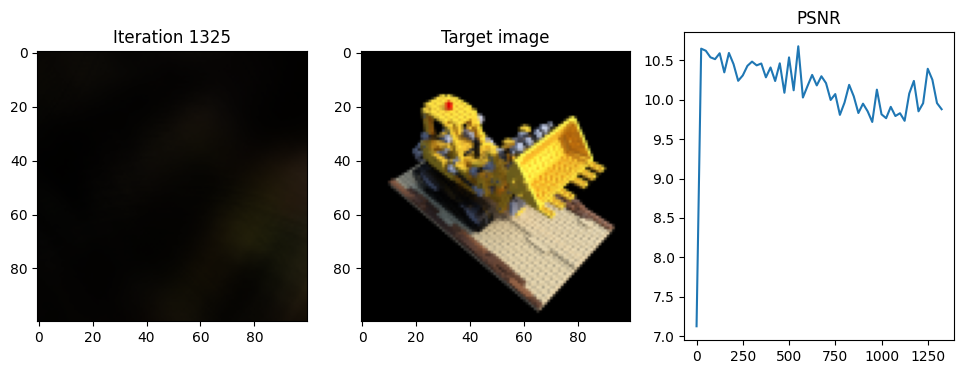

Iteration 1350  Loss: 0.1007  PSNR: 9.97  Time: 0.33 secs per iter,  12.46 mins in total
The rotation error as compared to GT Rotation : 0.5505385518074035


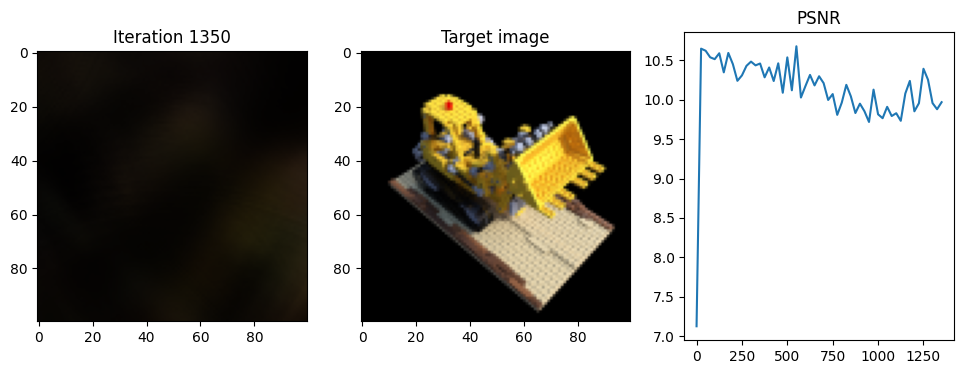

Iteration 1375  Loss: 0.1014  PSNR: 9.94  Time: 0.33 secs per iter,  12.60 mins in total
The rotation error as compared to GT Rotation : 0.5505632495880127


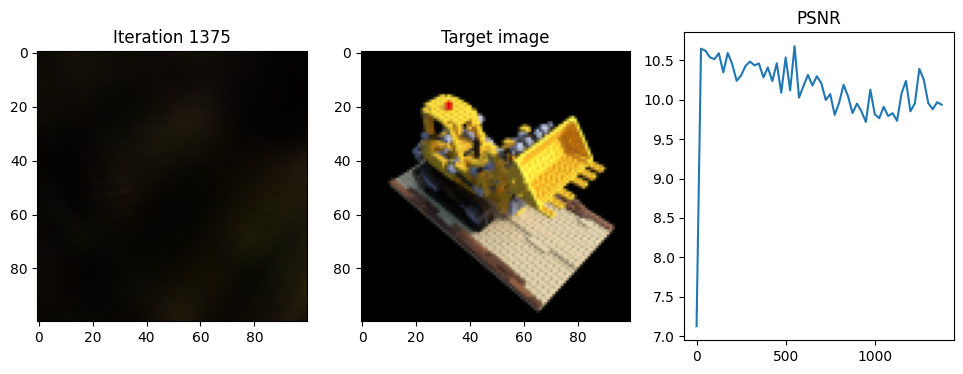

Iteration 1400  Loss: 0.1030  PSNR: 9.87  Time: 0.33 secs per iter,  12.74 mins in total
The rotation error as compared to GT Rotation : 0.5505049514770508


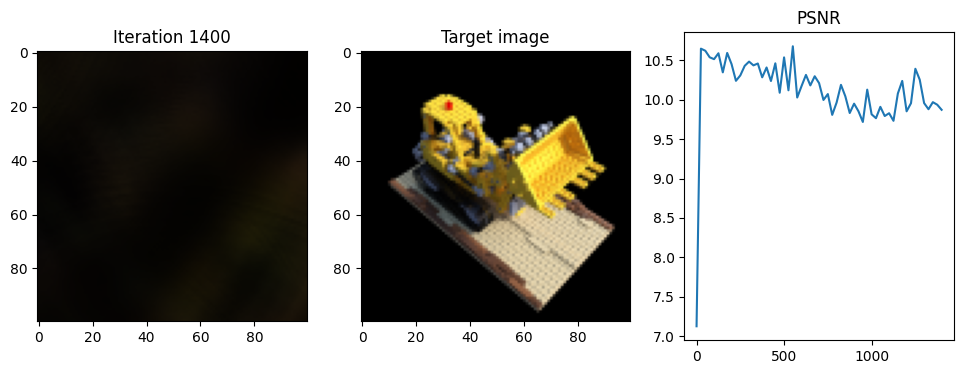

Iteration 1425  Loss: 0.1065  PSNR: 9.73  Time: 0.33 secs per iter,  12.88 mins in total
The rotation error as compared to GT Rotation : 0.5504716348648071


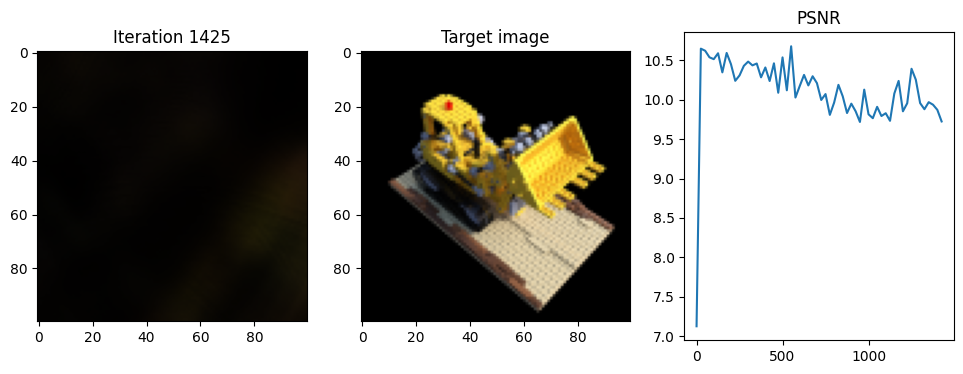

Iteration 1450  Loss: 0.0903  PSNR: 10.44  Time: 0.34 secs per iter,  13.02 mins in total
The rotation error as compared to GT Rotation : 0.5504908275604248


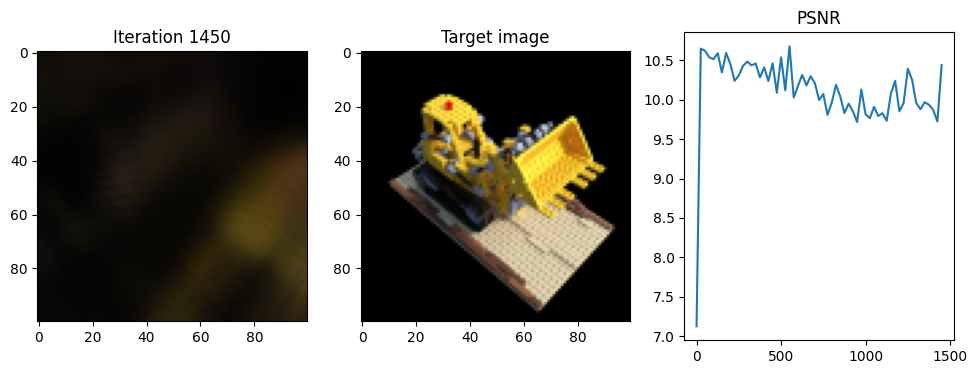

Iteration 1475  Loss: 0.0992  PSNR: 10.03  Time: 0.33 secs per iter,  13.15 mins in total
The rotation error as compared to GT Rotation : 0.5505933547019959


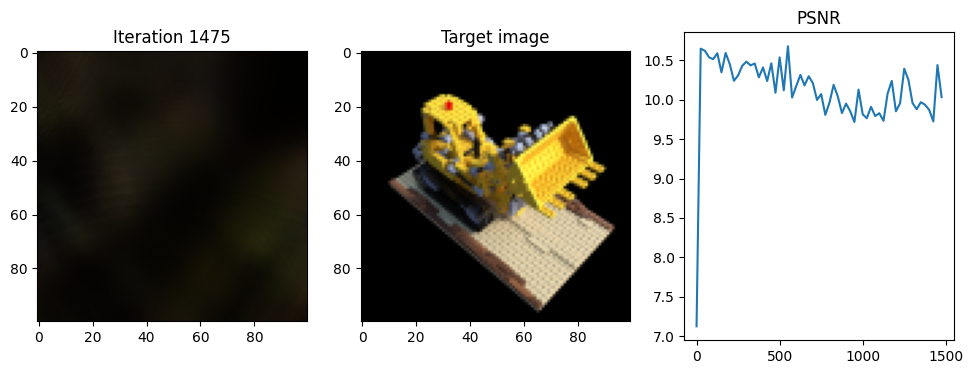

Iteration 1500  Loss: 0.1062  PSNR: 9.74  Time: 0.33 secs per iter,  13.29 mins in total
The rotation error as compared to GT Rotation : 0.5505750679969788


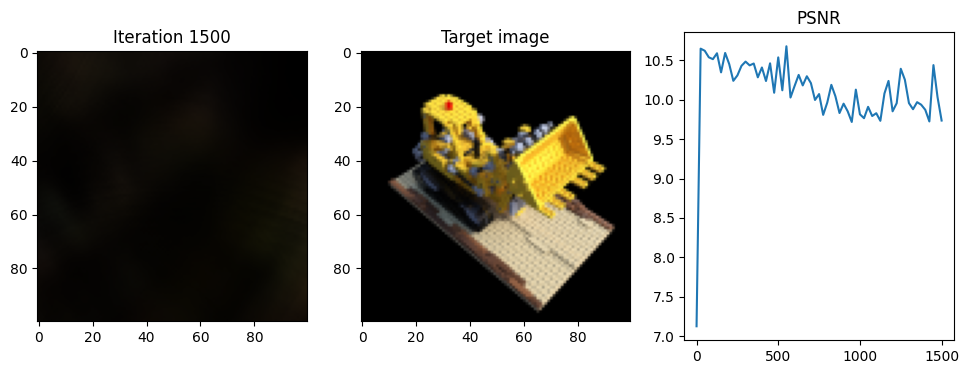

Iteration 1525  Loss: 0.1077  PSNR: 9.68  Time: 0.33 secs per iter,  13.43 mins in total
The rotation error as compared to GT Rotation : 0.5505724501609802


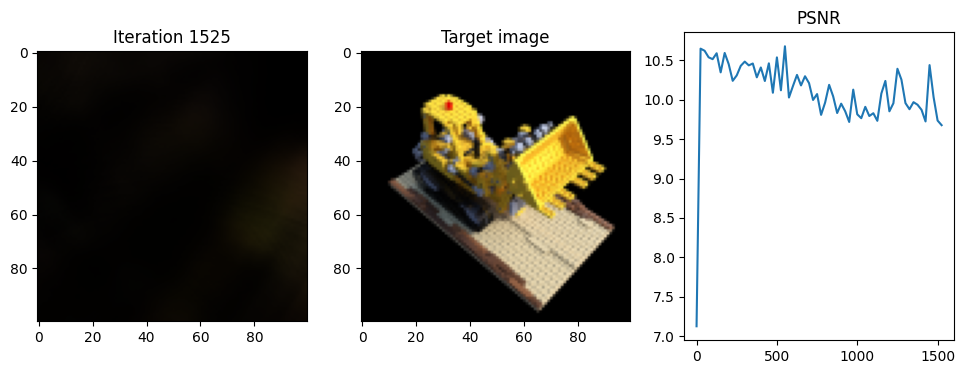

Iteration 1550  Loss: 0.0991  PSNR: 10.04  Time: 0.33 secs per iter,  13.57 mins in total
The rotation error as compared to GT Rotation : 0.5506031799316407


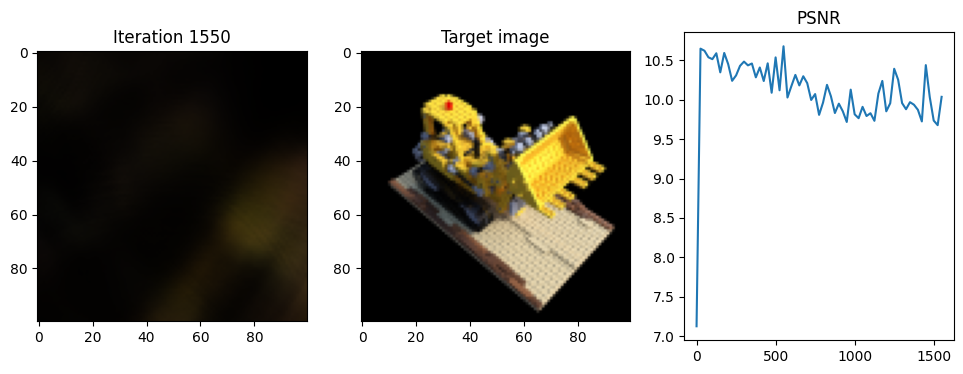

Iteration 1575  Loss: 0.1070  PSNR: 9.71  Time: 0.33 secs per iter,  13.71 mins in total
The rotation error as compared to GT Rotation : 0.550525336265564


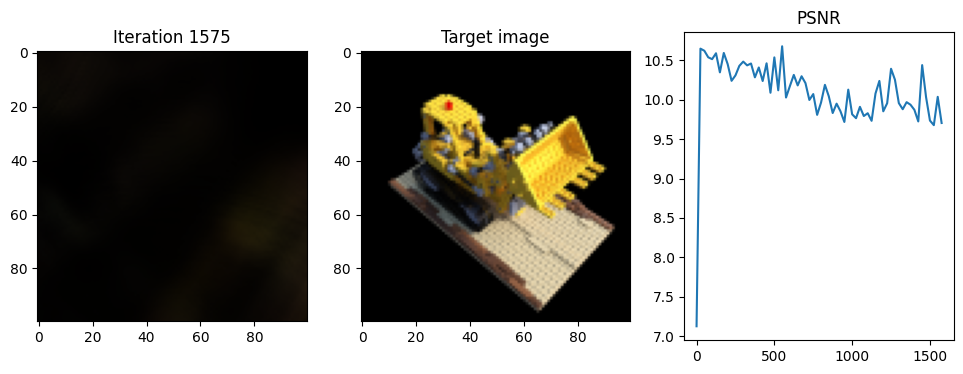

Iteration 1600  Loss: 0.1054  PSNR: 9.77  Time: 0.33 secs per iter,  13.84 mins in total
The rotation error as compared to GT Rotation : 0.5504767298698425


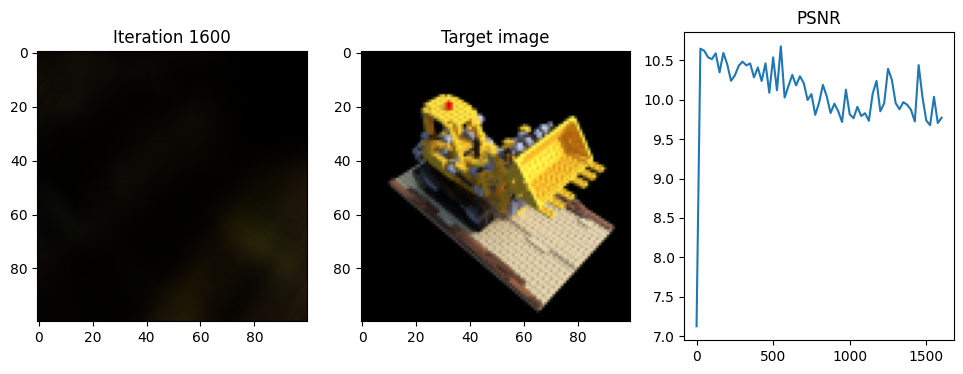

Iteration 1625  Loss: 0.1028  PSNR: 9.88  Time: 0.33 secs per iter,  13.98 mins in total
The rotation error as compared to GT Rotation : 0.5504697227478027


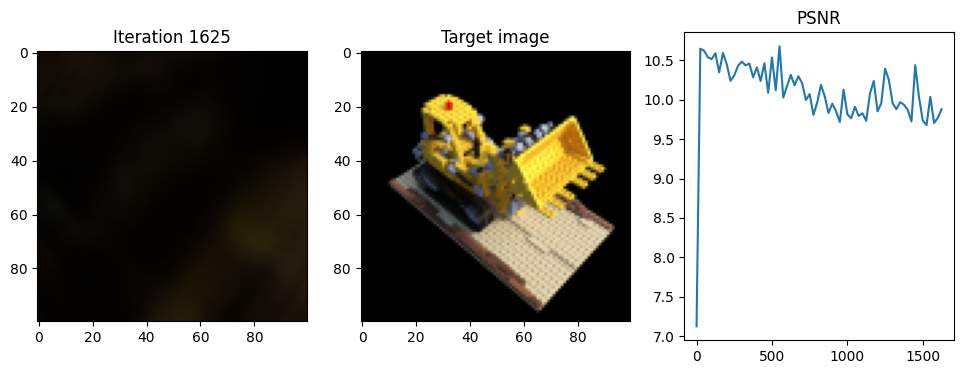

Iteration 1650  Loss: 0.0979  PSNR: 10.09  Time: 0.34 secs per iter,  14.12 mins in total
The rotation error as compared to GT Rotation : 0.550479588508606


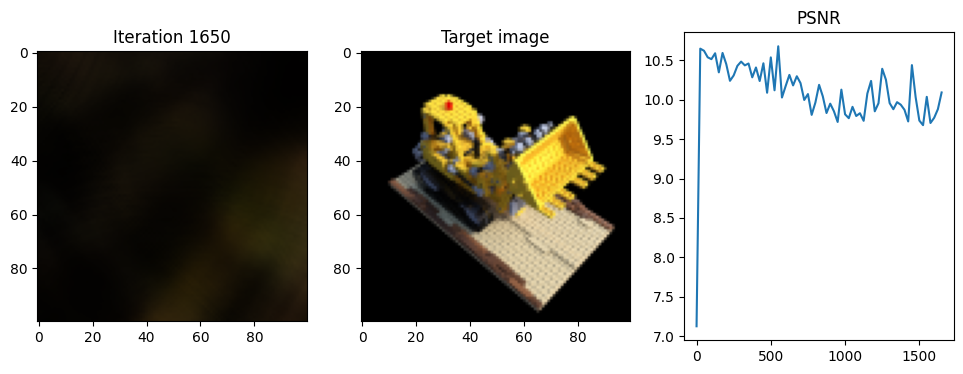

Iteration 1675  Loss: 0.1009  PSNR: 9.96  Time: 0.33 secs per iter,  14.26 mins in total
The rotation error as compared to GT Rotation : 0.5504512023925782


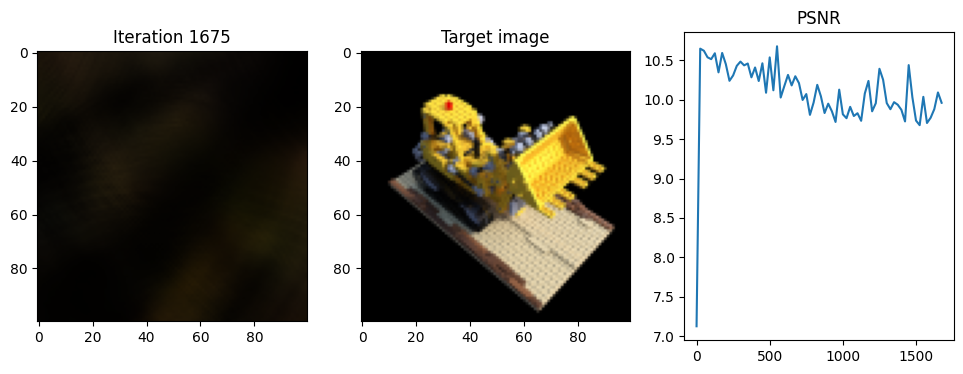

Iteration 1700  Loss: 0.1014  PSNR: 9.94  Time: 0.33 secs per iter,  14.40 mins in total
The rotation error as compared to GT Rotation : 0.5505869960784913


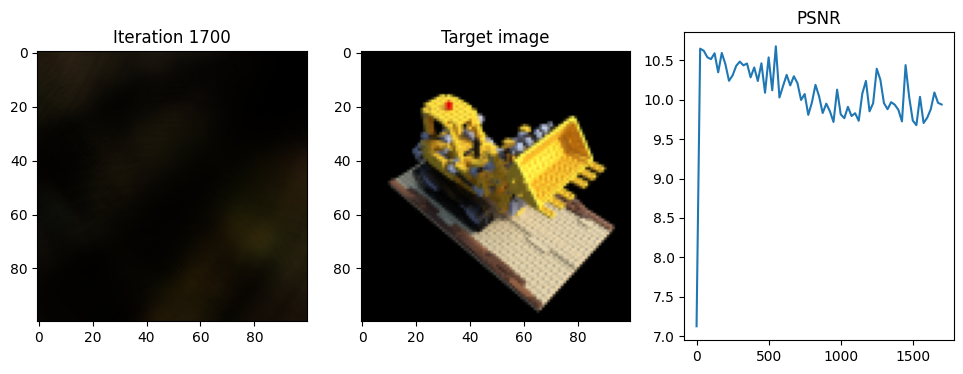

Iteration 1725  Loss: 0.1079  PSNR: 9.67  Time: 0.33 secs per iter,  14.54 mins in total
The rotation error as compared to GT Rotation : 0.5505800080299378


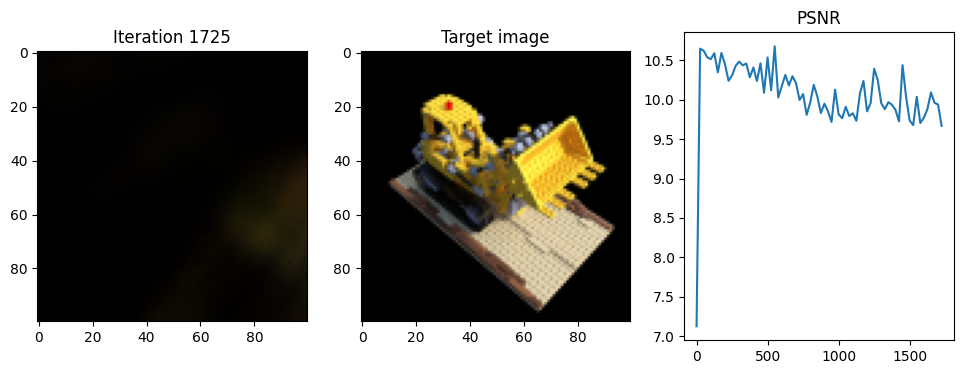

Iteration 1750  Loss: 0.0990  PSNR: 10.04  Time: 0.33 secs per iter,  14.67 mins in total
The rotation error as compared to GT Rotation : 0.5504863667488098


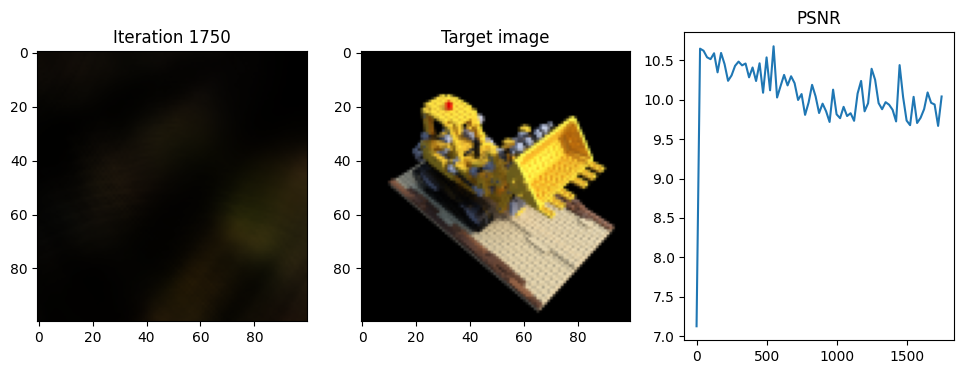

Iteration 1775  Loss: 0.1007  PSNR: 9.97  Time: 0.33 secs per iter,  14.81 mins in total
The rotation error as compared to GT Rotation : 0.5504943037033081


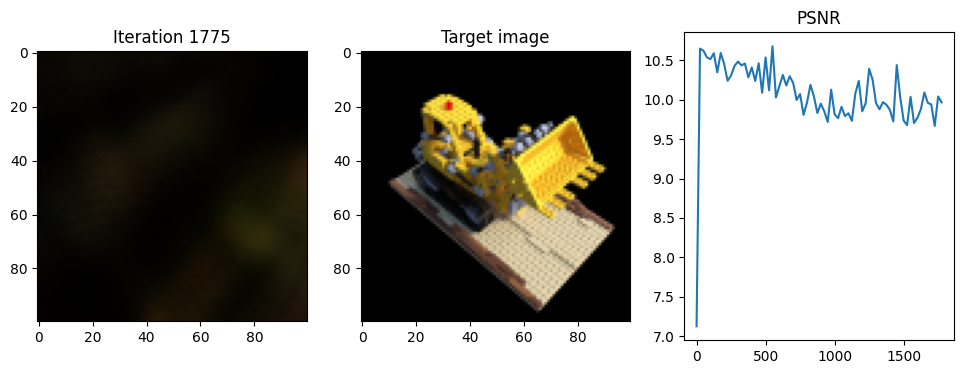

Iteration 1800  Loss: 0.0960  PSNR: 10.18  Time: 0.33 secs per iter,  14.95 mins in total
The rotation error as compared to GT Rotation : 0.5505039596557617


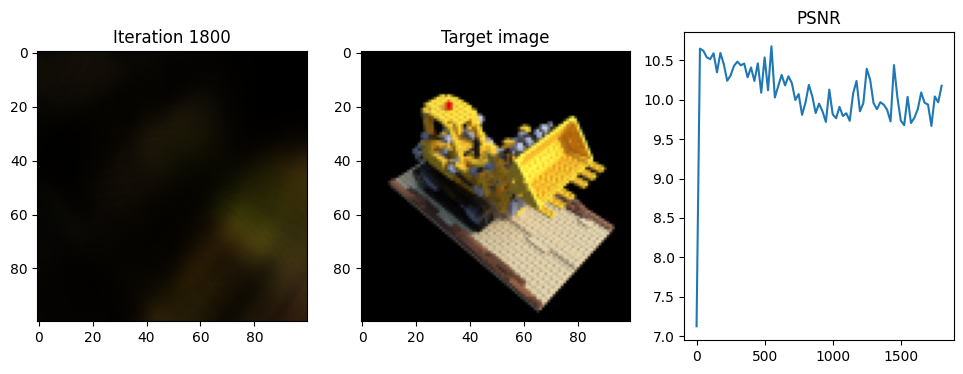

Iteration 1825  Loss: 0.0844  PSNR: 10.74  Time: 0.33 secs per iter,  15.09 mins in total
The rotation error as compared to GT Rotation : 0.5504821872711182


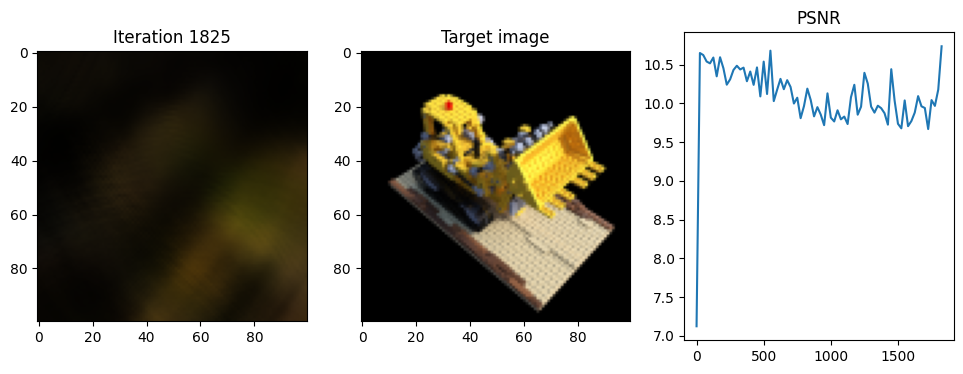

Iteration 1850  Loss: 0.0908  PSNR: 10.42  Time: 0.34 secs per iter,  15.23 mins in total
The rotation error as compared to GT Rotation : 0.5504729080200196


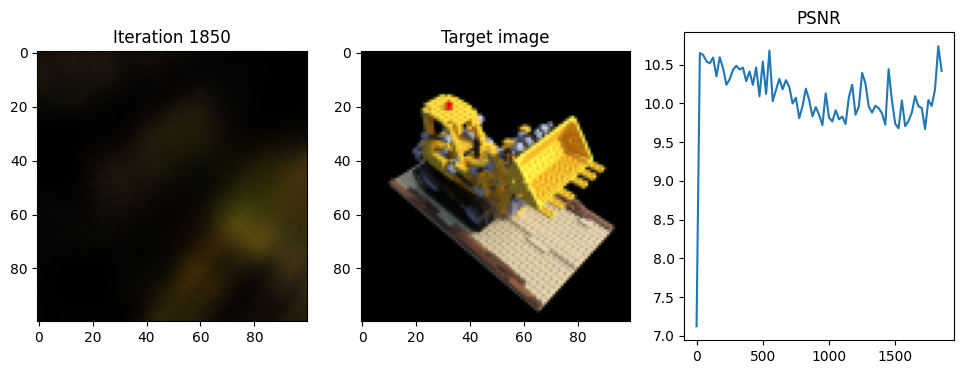

Iteration 1875  Loss: 0.0982  PSNR: 10.08  Time: 0.33 secs per iter,  15.37 mins in total
The rotation error as compared to GT Rotation : 0.5505516076087952


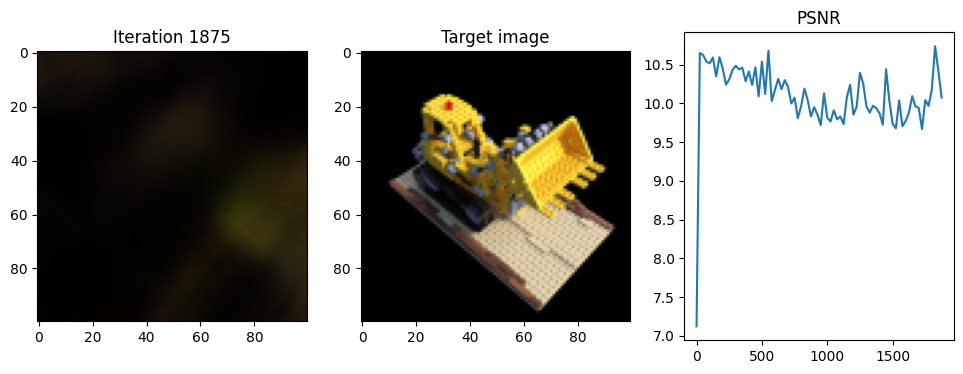

Iteration 1900  Loss: 0.0980  PSNR: 10.09  Time: 0.33 secs per iter,  15.51 mins in total
The rotation error as compared to GT Rotation : 0.5505533051490784


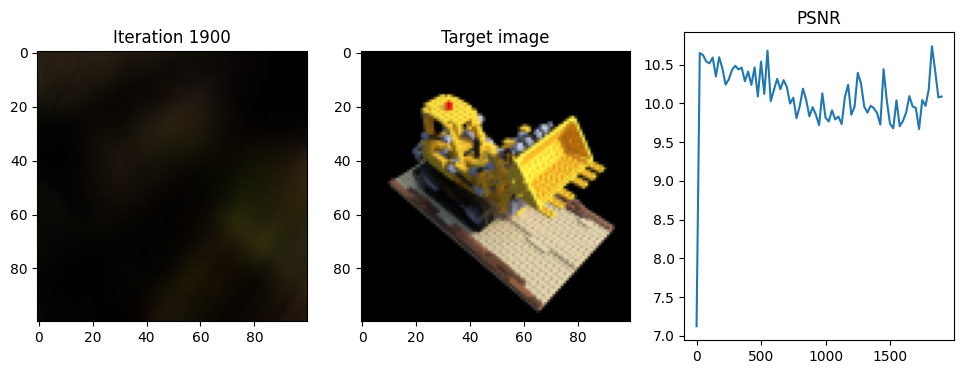

Iteration 1925  Loss: 0.0857  PSNR: 10.67  Time: 0.33 secs per iter,  15.64 mins in total
The rotation error as compared to GT Rotation : 0.5506080102920532


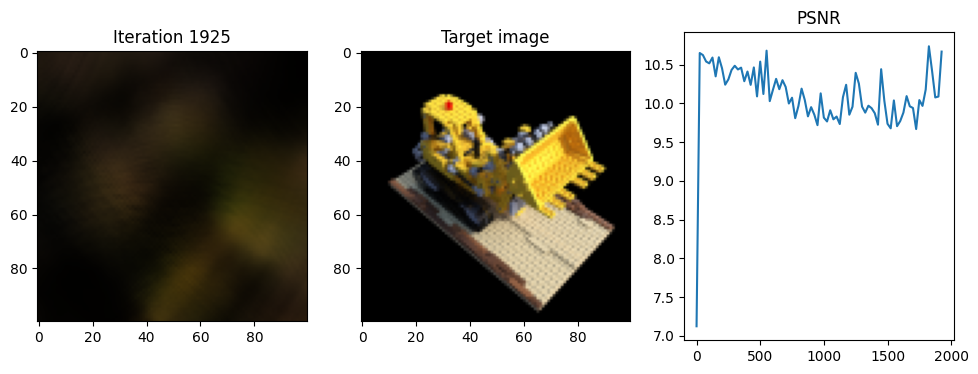

Iteration 1950  Loss: 0.0963  PSNR: 10.16  Time: 0.33 secs per iter,  15.78 mins in total
The rotation error as compared to GT Rotation : 0.5505575370788575


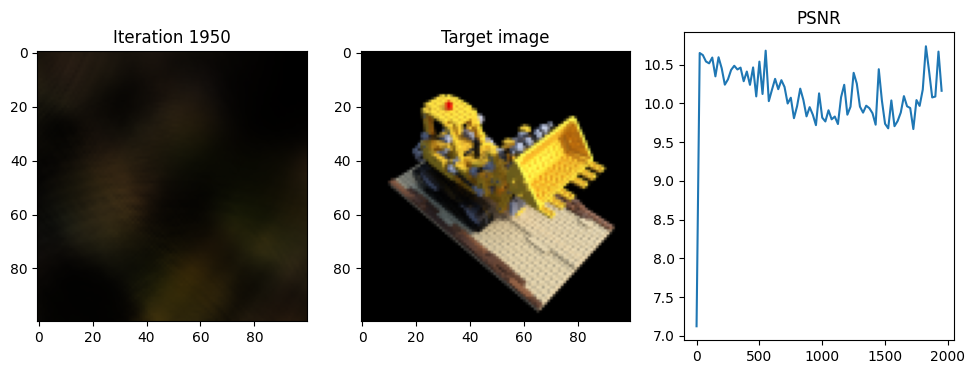

Iteration 1975  Loss: 0.1037  PSNR: 9.84  Time: 0.33 secs per iter,  15.92 mins in total
The rotation error as compared to GT Rotation : 0.5505440378189087


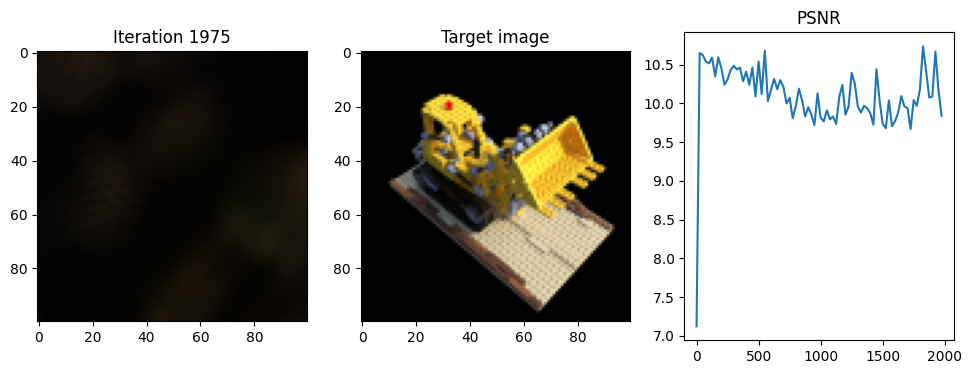

Iteration 2000  Loss: 0.0976  PSNR: 10.10  Time: 0.33 secs per iter,  16.06 mins in total
The rotation error as compared to GT Rotation : 0.5505168390274048


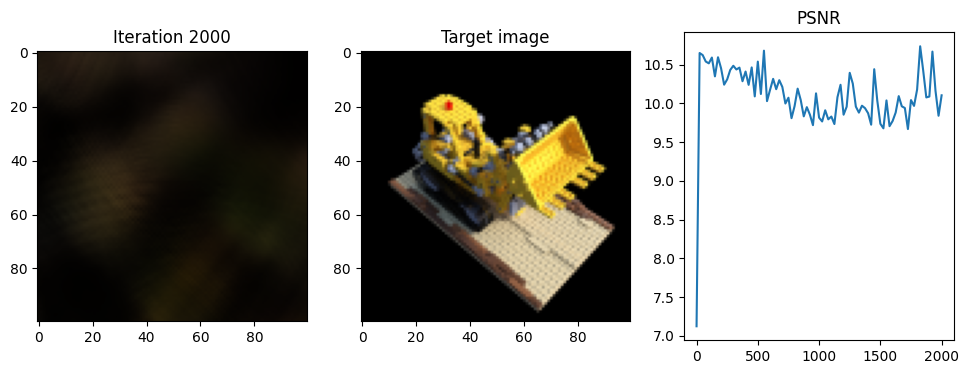

Iteration 2025  Loss: 0.1034  PSNR: 9.86  Time: 0.34 secs per iter,  16.20 mins in total
The rotation error as compared to GT Rotation : 0.5505195450782776


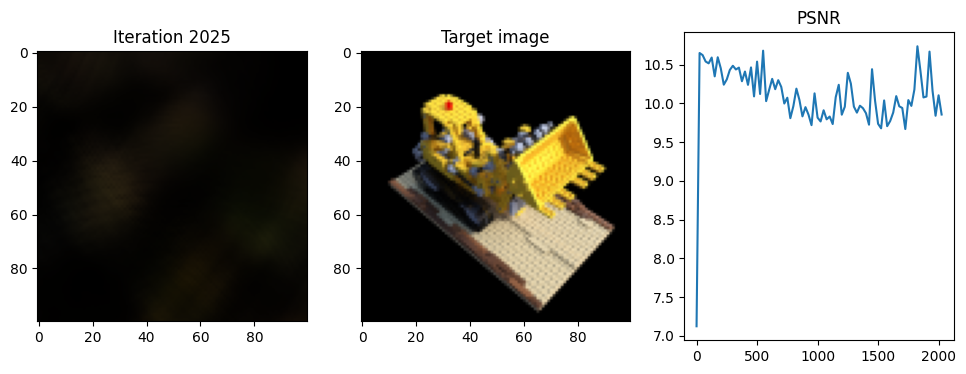

Iteration 2050  Loss: 0.0946  PSNR: 10.24  Time: 0.33 secs per iter,  16.34 mins in total
The rotation error as compared to GT Rotation : 0.5506172728538513


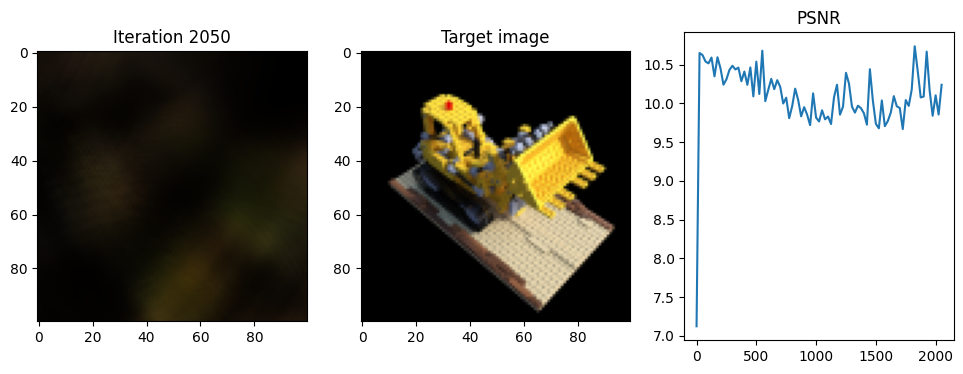

Iteration 2075  Loss: 0.0948  PSNR: 10.23  Time: 0.33 secs per iter,  16.47 mins in total
The rotation error as compared to GT Rotation : 0.5507039880752563


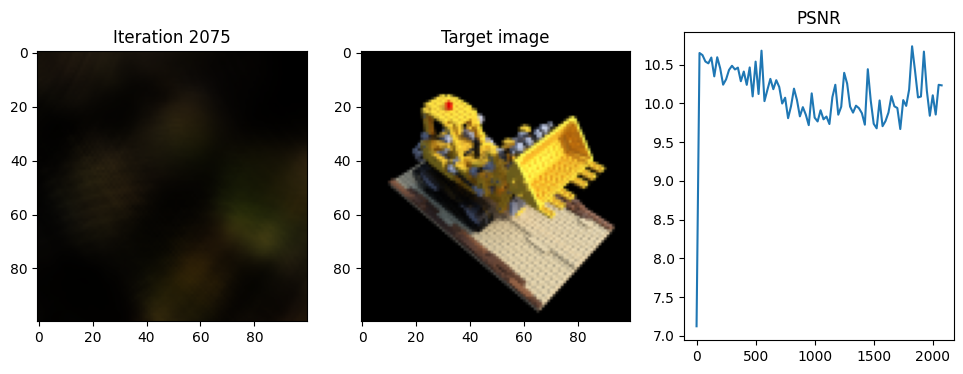

Iteration 2100  Loss: 0.1060  PSNR: 9.75  Time: 0.33 secs per iter,  16.61 mins in total
The rotation error as compared to GT Rotation : 0.5505701160430908


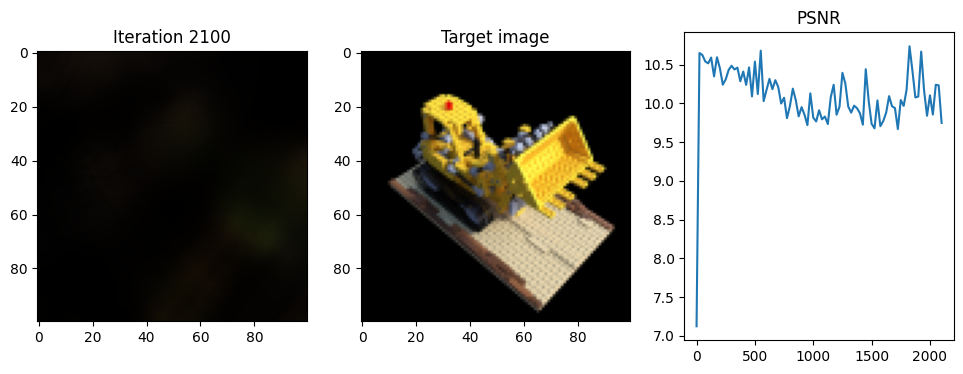

Iteration 2125  Loss: 0.0995  PSNR: 10.02  Time: 0.33 secs per iter,  16.75 mins in total
The rotation error as compared to GT Rotation : 0.5506212711334229


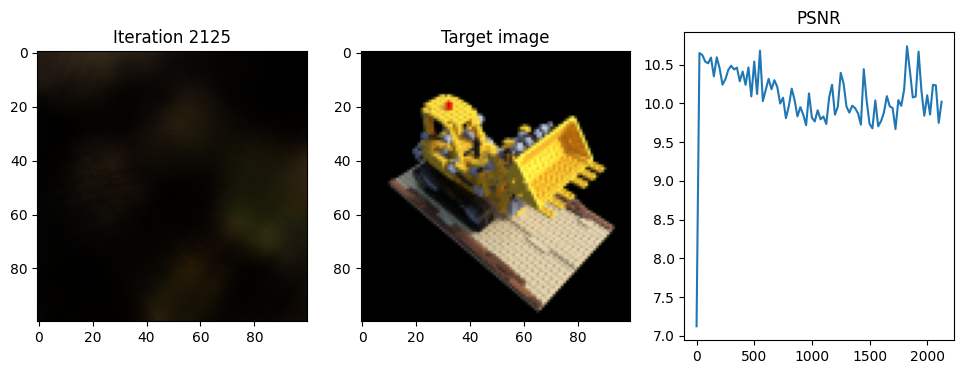

Iteration 2150  Loss: 0.0894  PSNR: 10.49  Time: 0.33 secs per iter,  16.89 mins in total
The rotation error as compared to GT Rotation : 0.5505502462387085


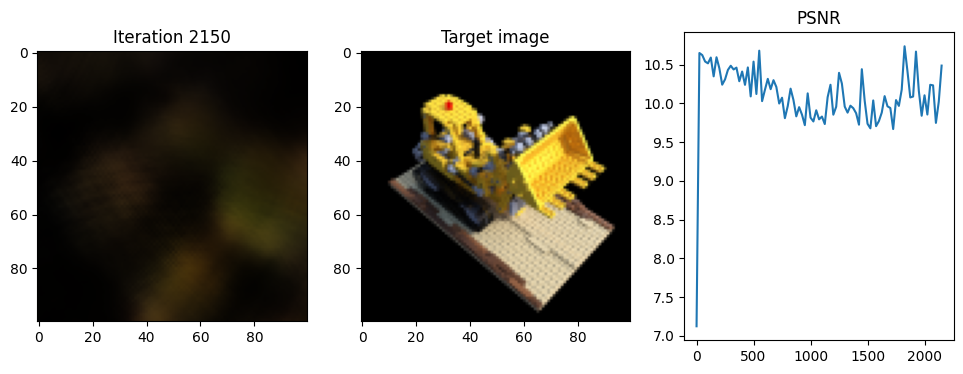

Iteration 2175  Loss: 0.1045  PSNR: 9.81  Time: 0.33 secs per iter,  17.03 mins in total
The rotation error as compared to GT Rotation : 0.5506108665466308


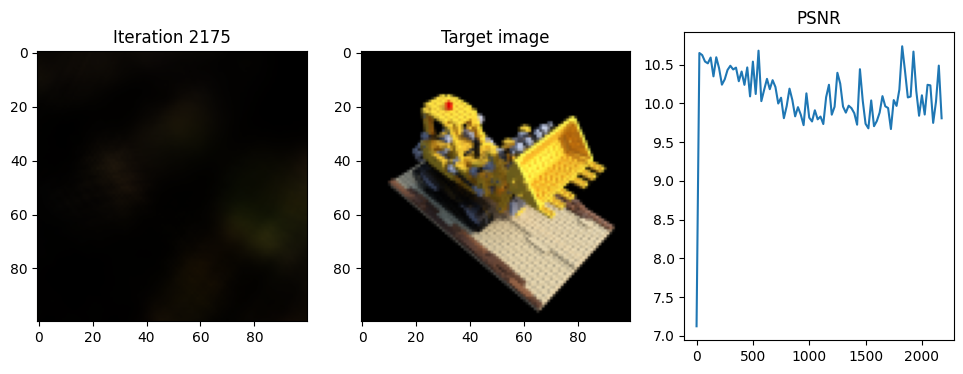

Iteration 2200  Loss: 0.1036  PSNR: 9.85  Time: 0.33 secs per iter,  17.16 mins in total
The rotation error as compared to GT Rotation : 0.5506004548072815


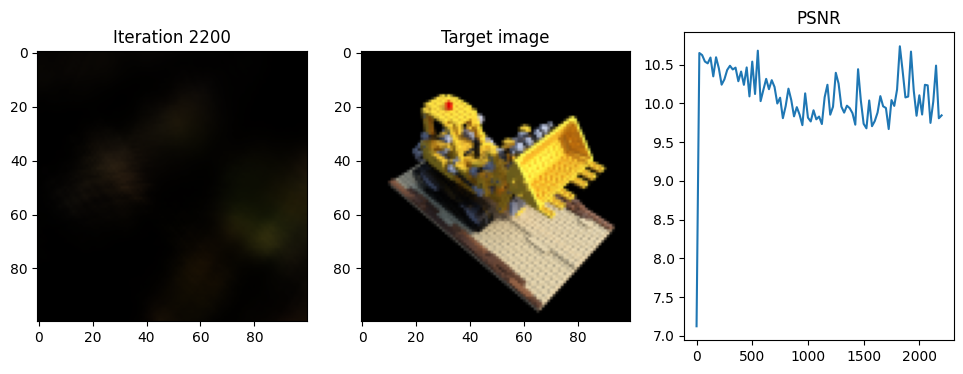

Iteration 2225  Loss: 0.1035  PSNR: 9.85  Time: 0.34 secs per iter,  17.30 mins in total
The rotation error as compared to GT Rotation : 0.550619957447052


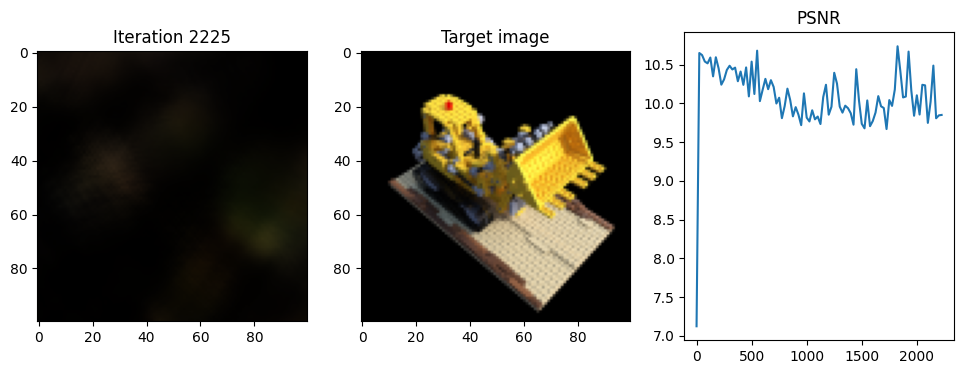

Iteration 2250  Loss: 0.1011  PSNR: 9.95  Time: 0.33 secs per iter,  17.44 mins in total
The rotation error as compared to GT Rotation : 0.5506170129776001


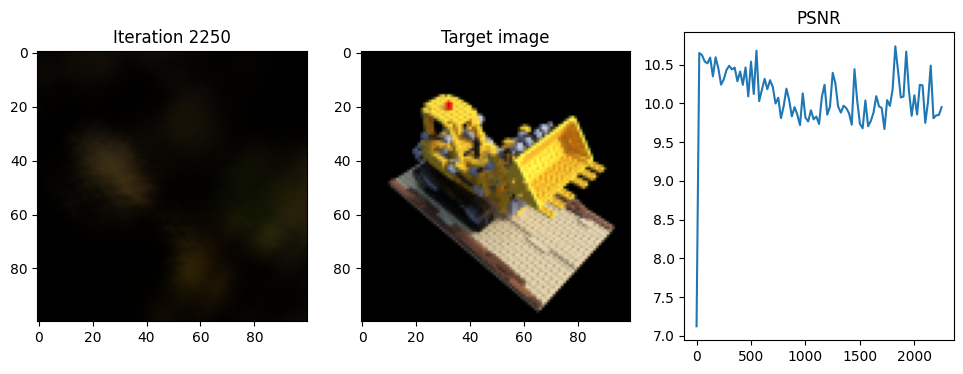

Iteration 2275  Loss: 0.0953  PSNR: 10.21  Time: 0.33 secs per iter,  17.58 mins in total
The rotation error as compared to GT Rotation : 0.5506433796882629


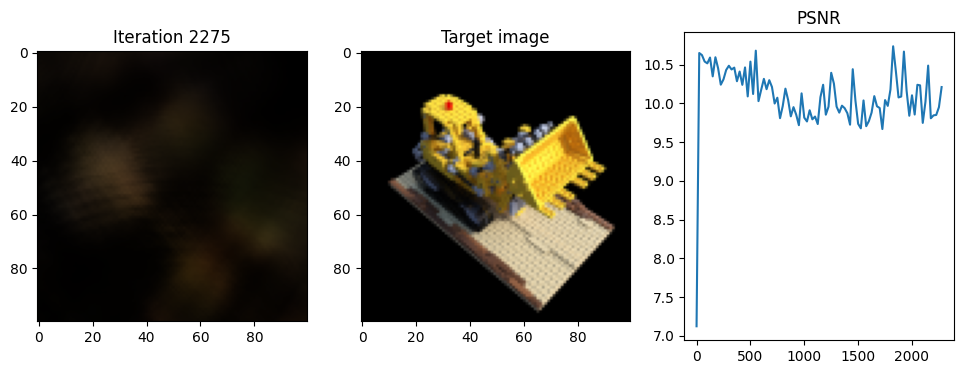

Iteration 2300  Loss: 0.1139  PSNR: 9.43  Time: 0.33 secs per iter,  17.72 mins in total
The rotation error as compared to GT Rotation : 0.5506236052513123


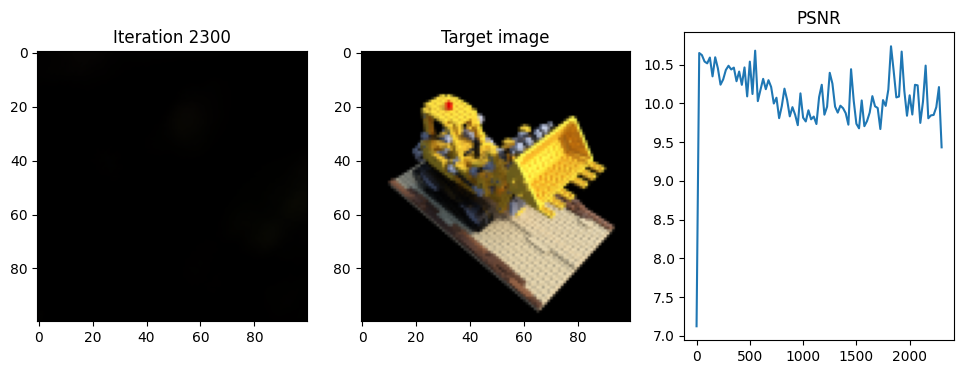

Iteration 2325  Loss: 0.1060  PSNR: 9.75  Time: 0.33 secs per iter,  17.86 mins in total
The rotation error as compared to GT Rotation : 0.5506988668441772


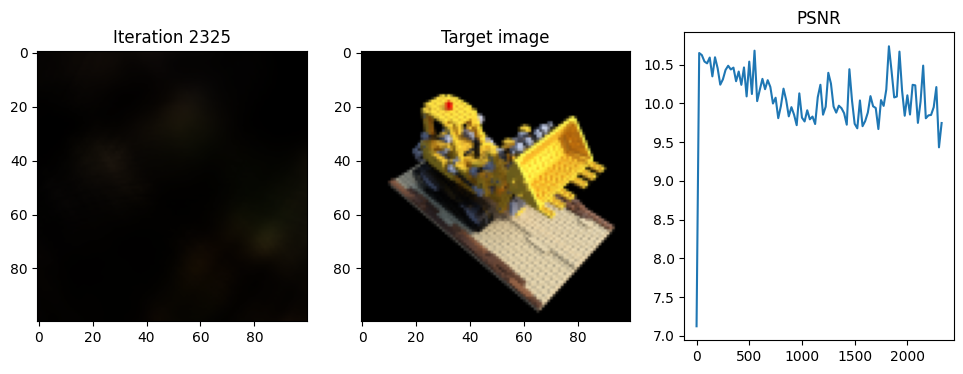

Iteration 2350  Loss: 0.1111  PSNR: 9.54  Time: 0.33 secs per iter,  18.00 mins in total
The rotation error as compared to GT Rotation : 0.5506334900856018


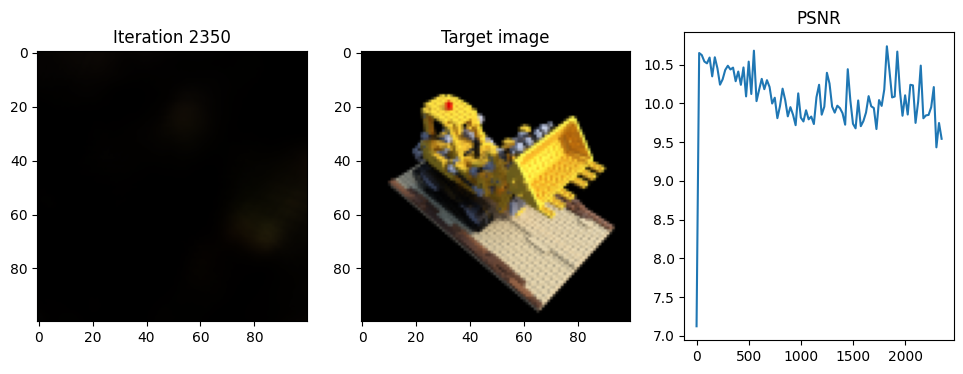

Iteration 2375  Loss: 0.1079  PSNR: 9.67  Time: 0.33 secs per iter,  18.13 mins in total
The rotation error as compared to GT Rotation : 0.5507185459136963


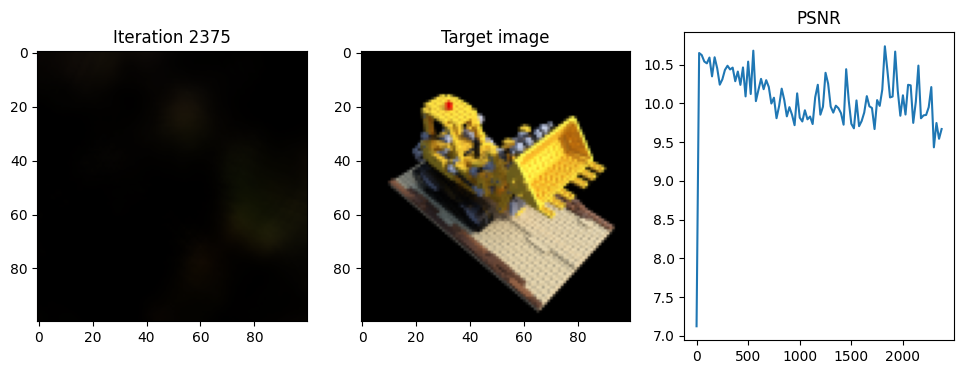

Iteration 2400  Loss: 0.1066  PSNR: 9.72  Time: 0.34 secs per iter,  18.27 mins in total
The rotation error as compared to GT Rotation : 0.550732491016388


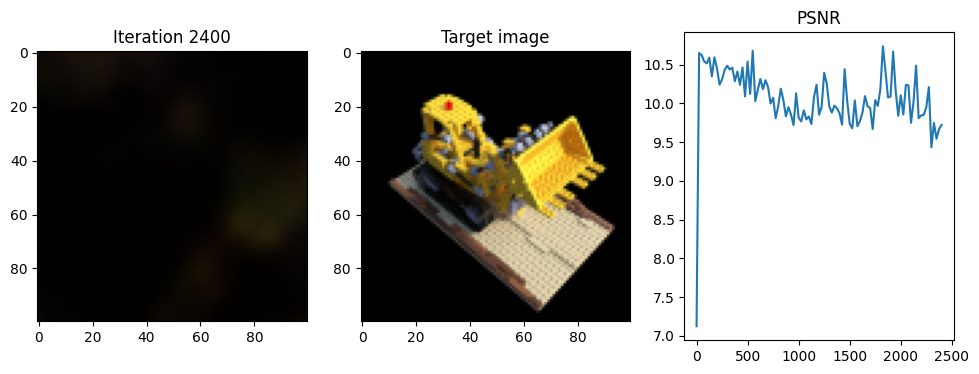

Iteration 2425  Loss: 0.0966  PSNR: 10.15  Time: 0.33 secs per iter,  18.41 mins in total
The rotation error as compared to GT Rotation : 0.5506793093681336


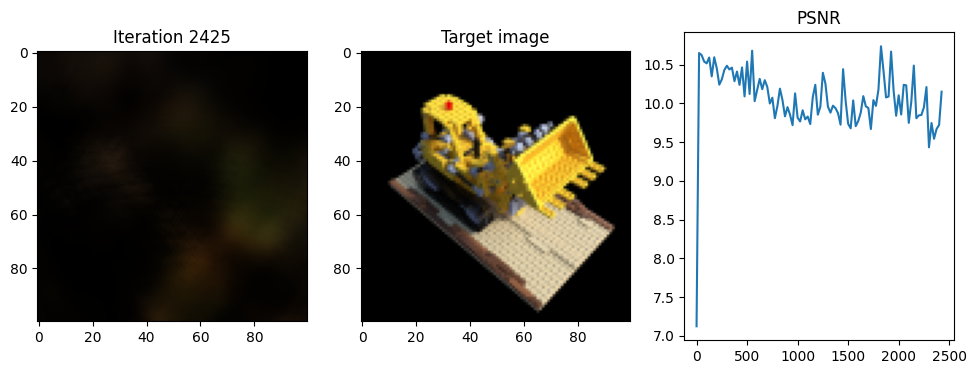

Iteration 2450  Loss: 0.0989  PSNR: 10.05  Time: 0.33 secs per iter,  18.55 mins in total
The rotation error as compared to GT Rotation : 0.5505738973617553


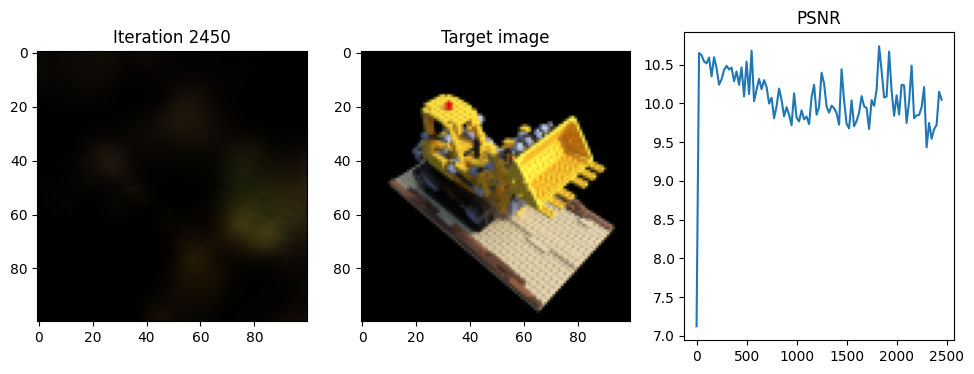

Iteration 2475  Loss: 0.1046  PSNR: 9.80  Time: 0.33 secs per iter,  18.69 mins in total
The rotation error as compared to GT Rotation : 0.5505999994277954


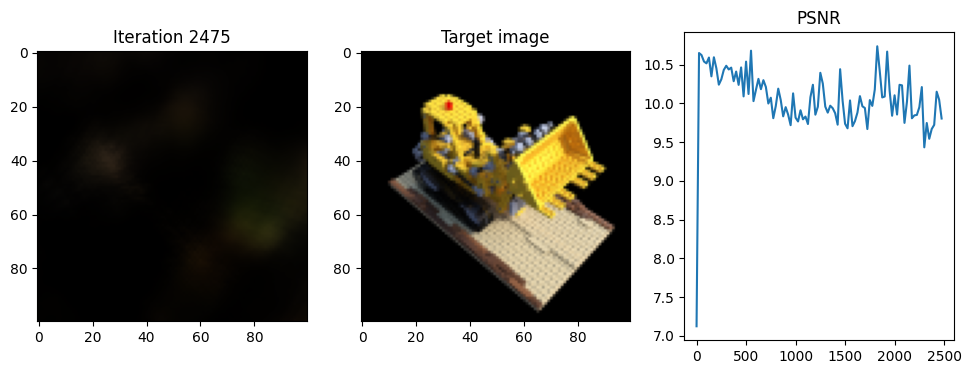

Iteration 2500  Loss: 0.1048  PSNR: 9.80  Time: 0.33 secs per iter,  18.83 mins in total
The rotation error as compared to GT Rotation : 0.5506522607803345


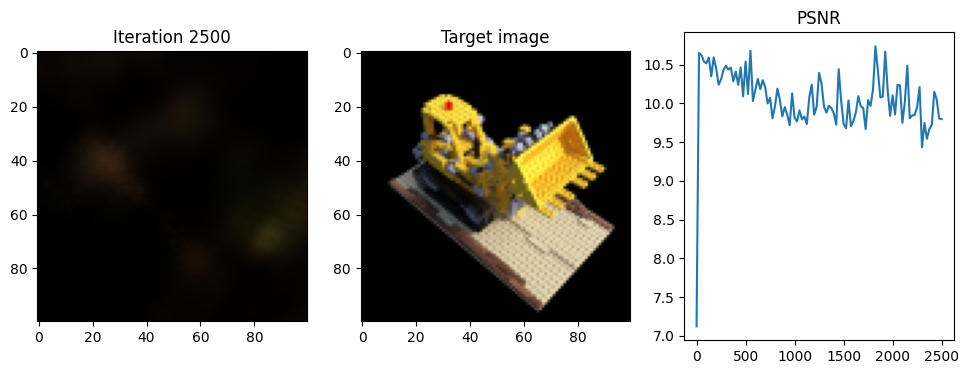

Iteration 2525  Loss: 0.1024  PSNR: 9.90  Time: 0.33 secs per iter,  18.96 mins in total
The rotation error as compared to GT Rotation : 0.5506382083892822


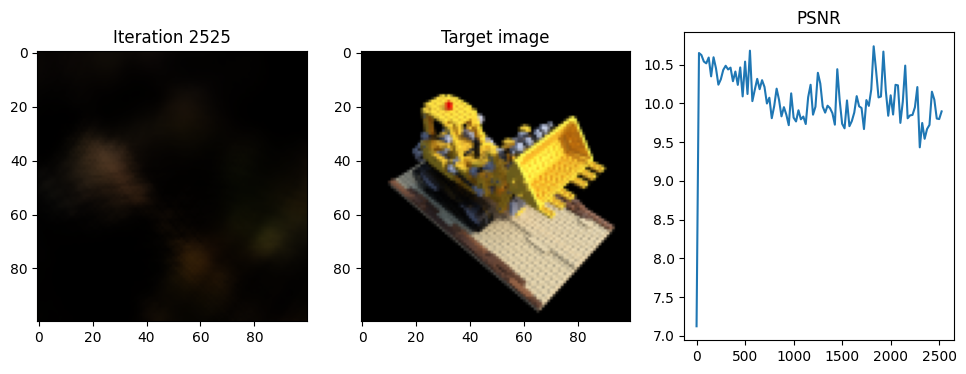

Iteration 2550  Loss: 0.1000  PSNR: 10.00  Time: 0.33 secs per iter,  19.10 mins in total
The rotation error as compared to GT Rotation : 0.5507276630401612


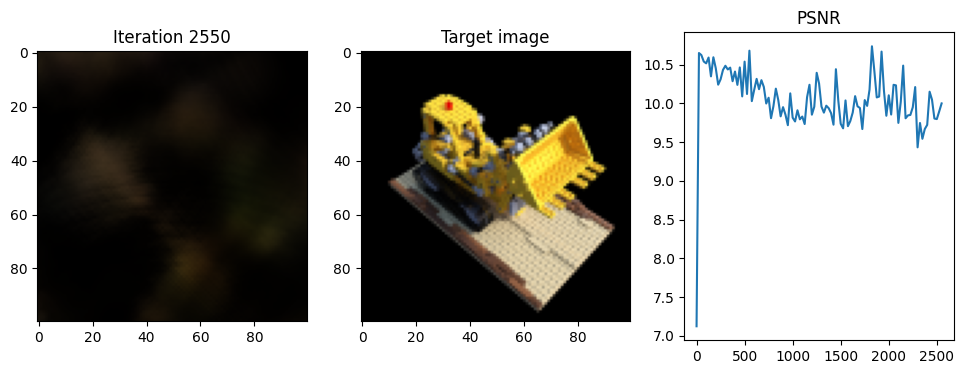

Iteration 2575  Loss: 0.0908  PSNR: 10.42  Time: 0.33 secs per iter,  19.24 mins in total
The rotation error as compared to GT Rotation : 0.5506402730941773


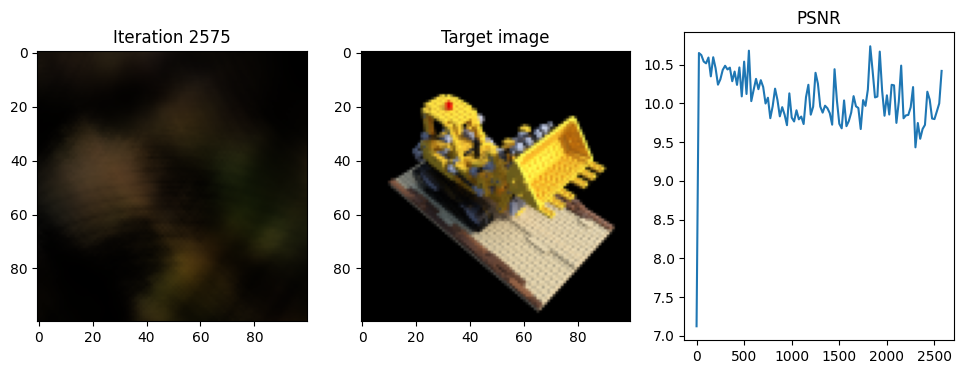

Iteration 2600  Loss: 0.0919  PSNR: 10.37  Time: 0.34 secs per iter,  19.38 mins in total
The rotation error as compared to GT Rotation : 0.5506534457206727


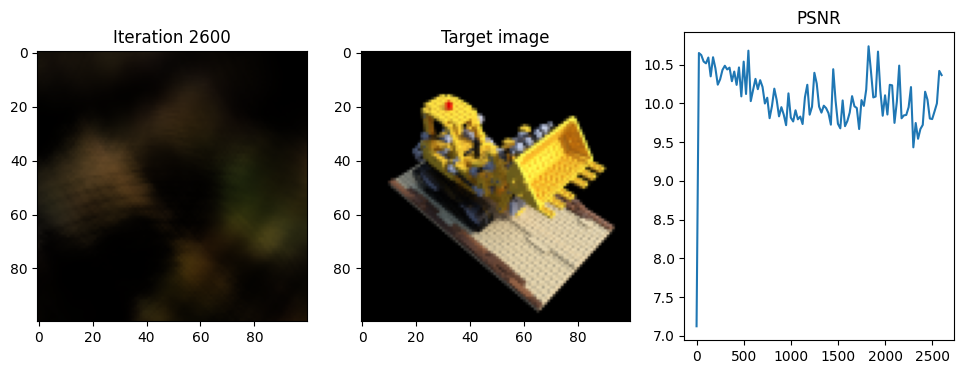

Iteration 2625  Loss: 0.0963  PSNR: 10.16  Time: 0.33 secs per iter,  19.52 mins in total
The rotation error as compared to GT Rotation : 0.5506704354286194


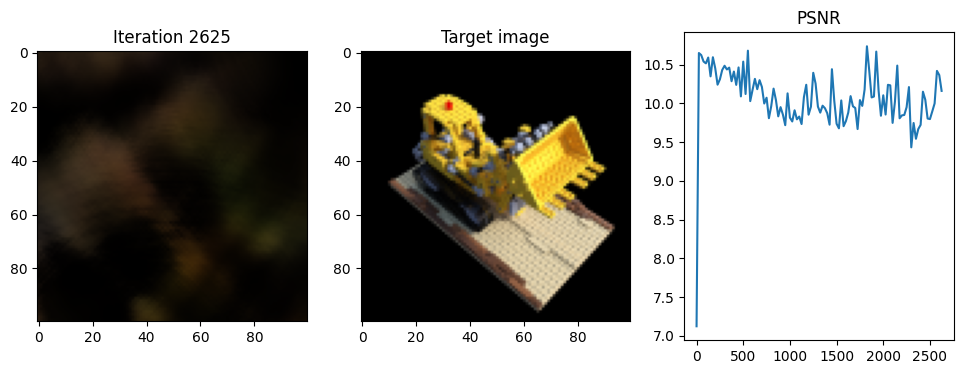

Iteration 2650  Loss: 0.0924  PSNR: 10.34  Time: 0.33 secs per iter,  19.66 mins in total
The rotation error as compared to GT Rotation : 0.5506446075439453


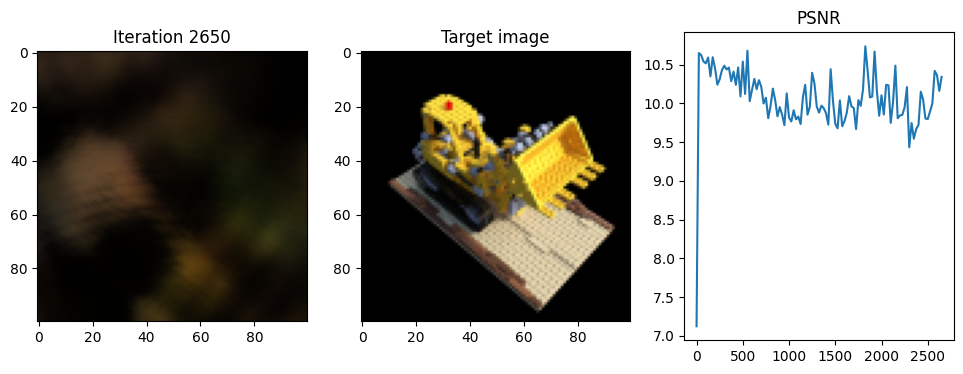

Iteration 2675  Loss: 0.0877  PSNR: 10.57  Time: 0.33 secs per iter,  19.80 mins in total
The rotation error as compared to GT Rotation : 0.5506541538238525


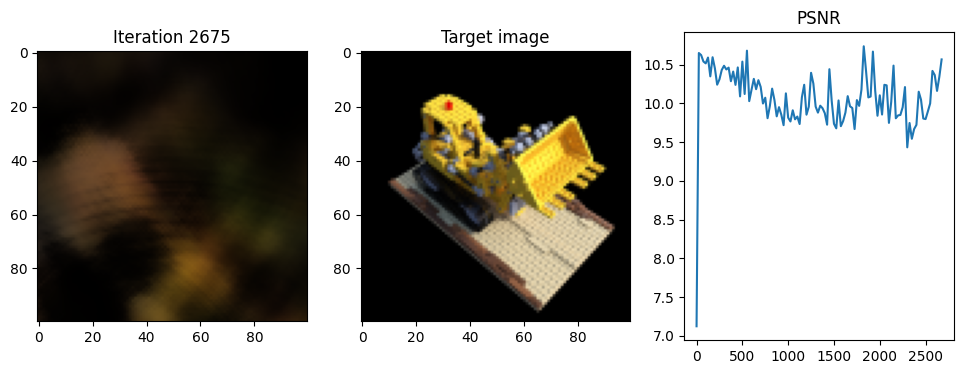

Iteration 2700  Loss: 0.0883  PSNR: 10.54  Time: 0.33 secs per iter,  19.93 mins in total
The rotation error as compared to GT Rotation : 0.5505929803848266


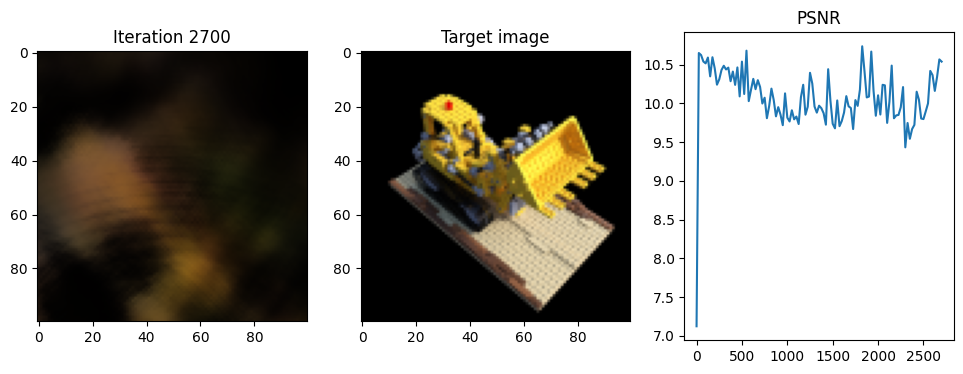

Iteration 2725  Loss: 0.1047  PSNR: 9.80  Time: 0.33 secs per iter,  20.07 mins in total
The rotation error as compared to GT Rotation : 0.550662305355072


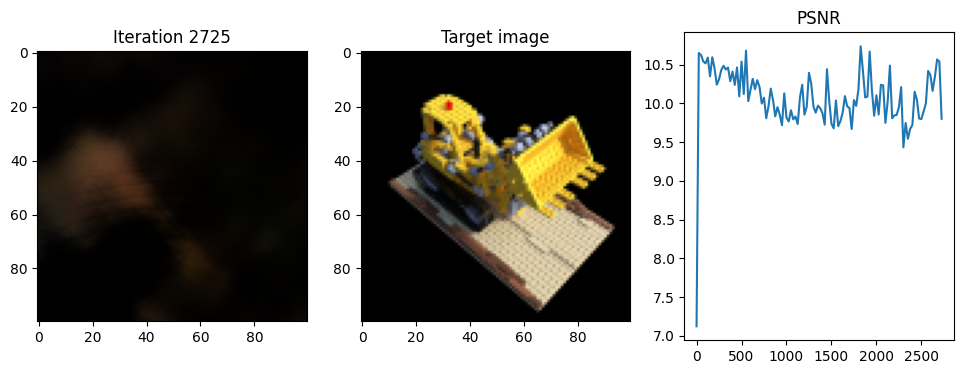

Iteration 2750  Loss: 0.0997  PSNR: 10.01  Time: 0.33 secs per iter,  20.21 mins in total
The rotation error as compared to GT Rotation : 0.5507116532325744


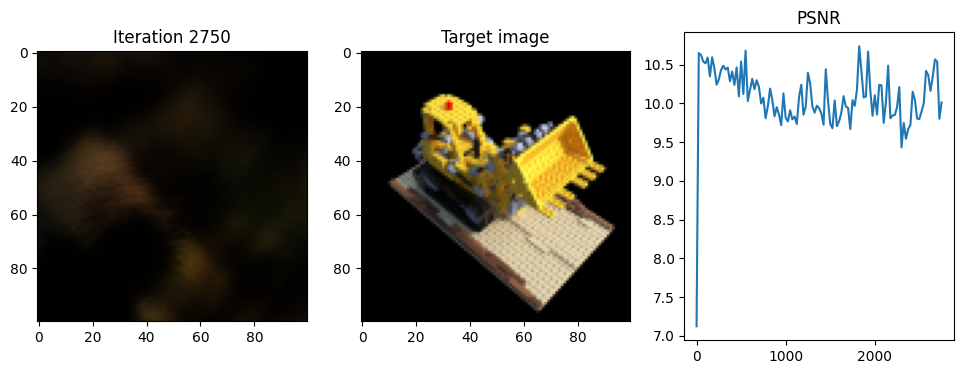

Iteration 2775  Loss: 0.0946  PSNR: 10.24  Time: 0.34 secs per iter,  20.35 mins in total
The rotation error as compared to GT Rotation : 0.5508480191230773


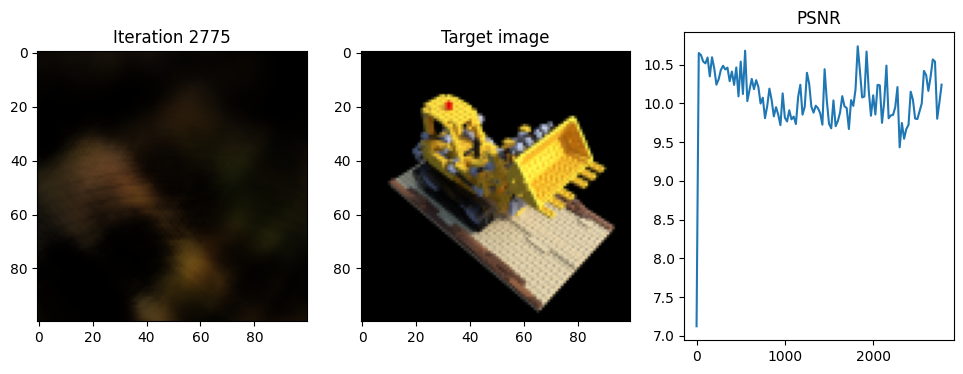

Iteration 2800  Loss: 0.0924  PSNR: 10.34  Time: 0.33 secs per iter,  20.49 mins in total
The rotation error as compared to GT Rotation : 0.5509364604949951


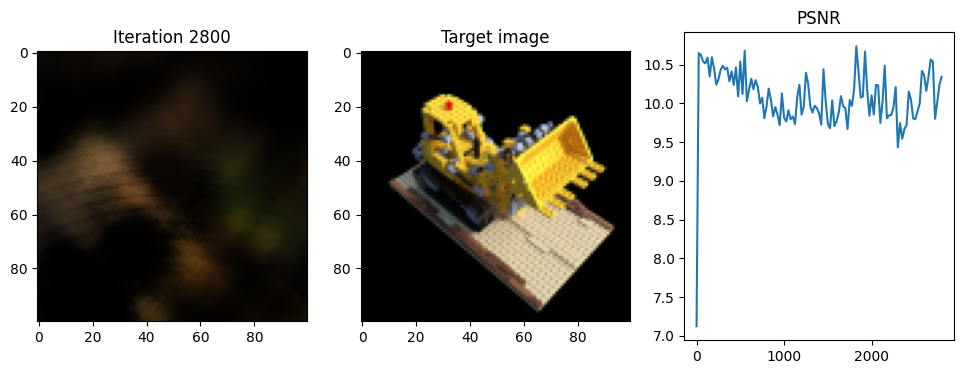

Iteration 2825  Loss: 0.1002  PSNR: 9.99  Time: 0.33 secs per iter,  20.63 mins in total
The rotation error as compared to GT Rotation : 0.5506967711448669


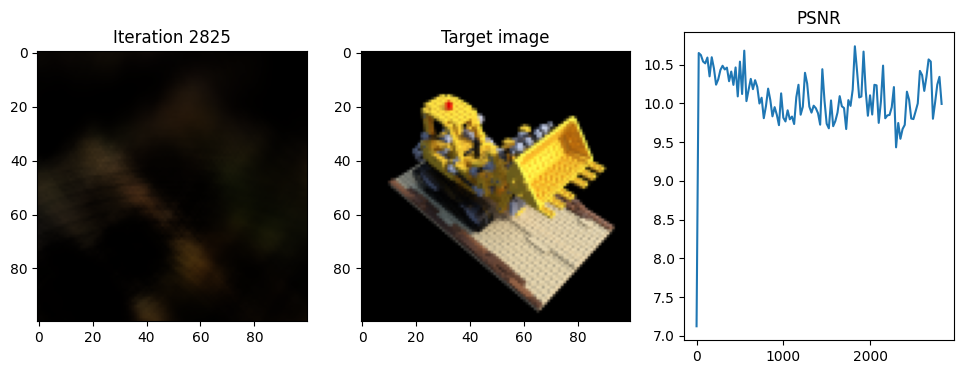

Iteration 2850  Loss: 0.0941  PSNR: 10.26  Time: 0.33 secs per iter,  20.76 mins in total
The rotation error as compared to GT Rotation : 0.5508121132850647


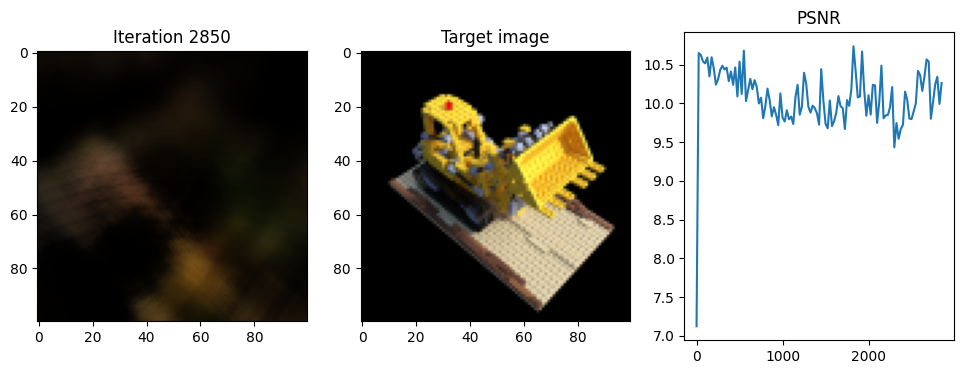

Iteration 2875  Loss: 0.1065  PSNR: 9.72  Time: 0.33 secs per iter,  20.90 mins in total
The rotation error as compared to GT Rotation : 0.5506538438796997


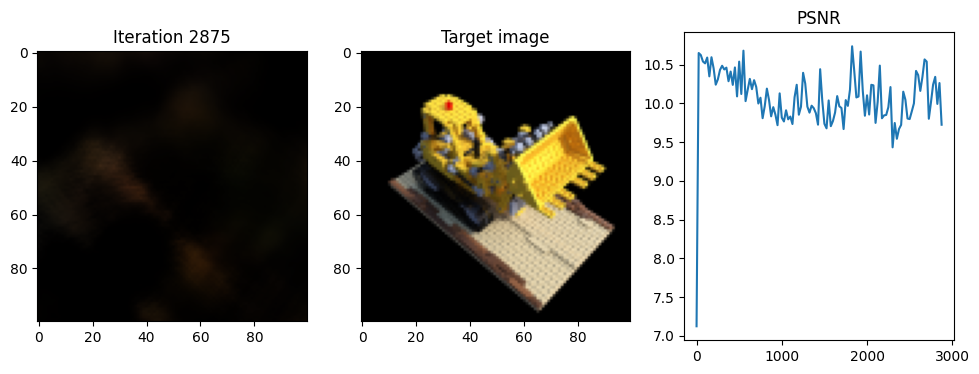

Iteration 2900  Loss: 0.0882  PSNR: 10.55  Time: 0.33 secs per iter,  21.04 mins in total
The rotation error as compared to GT Rotation : 0.5505874276161193


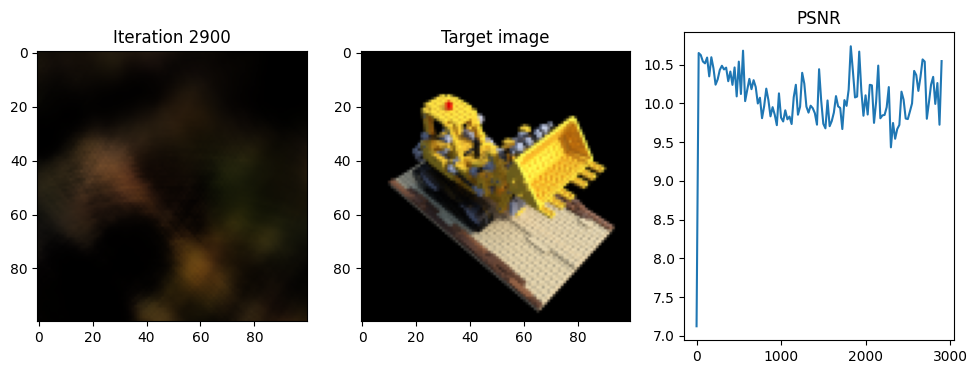

Iteration 2925  Loss: 0.1028  PSNR: 9.88  Time: 0.33 secs per iter,  21.18 mins in total
The rotation error as compared to GT Rotation : 0.5506848239898682


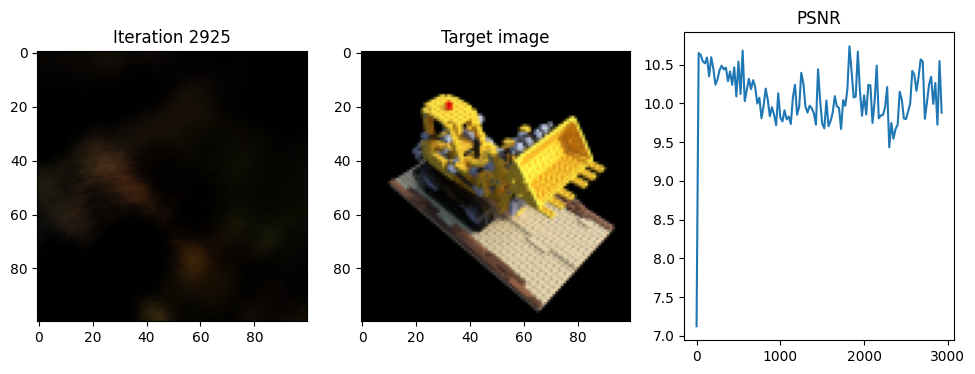

Iteration 2950  Loss: 0.0958  PSNR: 10.19  Time: 0.33 secs per iter,  21.32 mins in total
The rotation error as compared to GT Rotation : 0.55056147813797


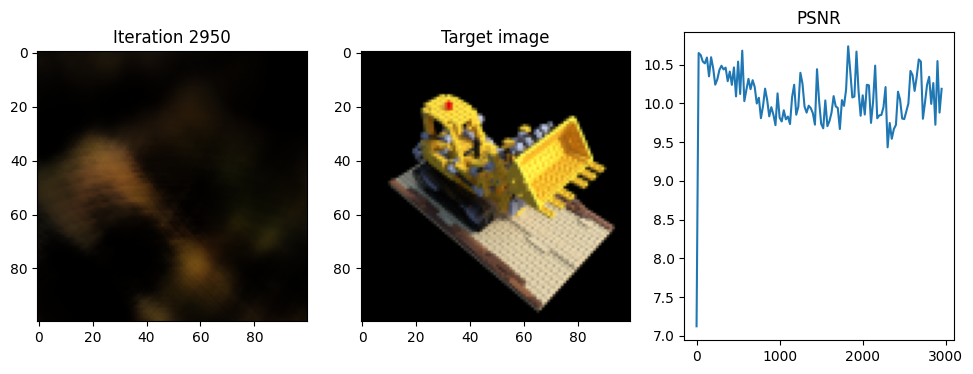

Iteration 2975  Loss: 0.0928  PSNR: 10.32  Time: 0.34 secs per iter,  21.46 mins in total
The rotation error as compared to GT Rotation : 0.5507697200775147


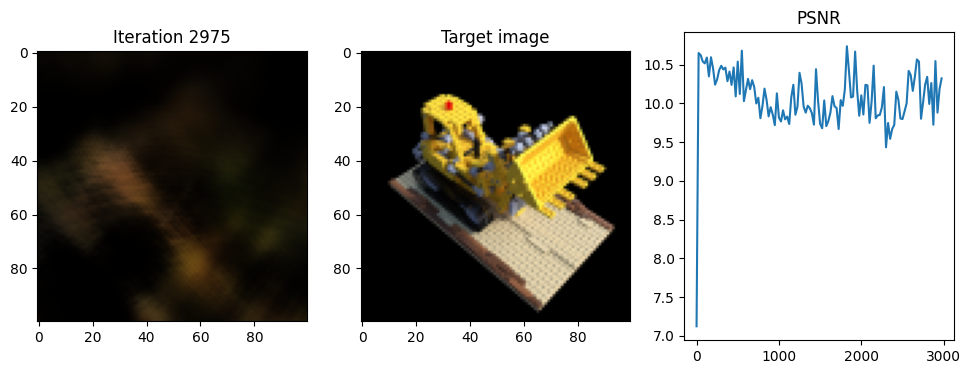

Iteration 3000  Loss: 0.0848  PSNR: 10.72  Time: 0.33 secs per iter,  21.60 mins in total
The rotation error as compared to GT Rotation : 0.5508510684967041


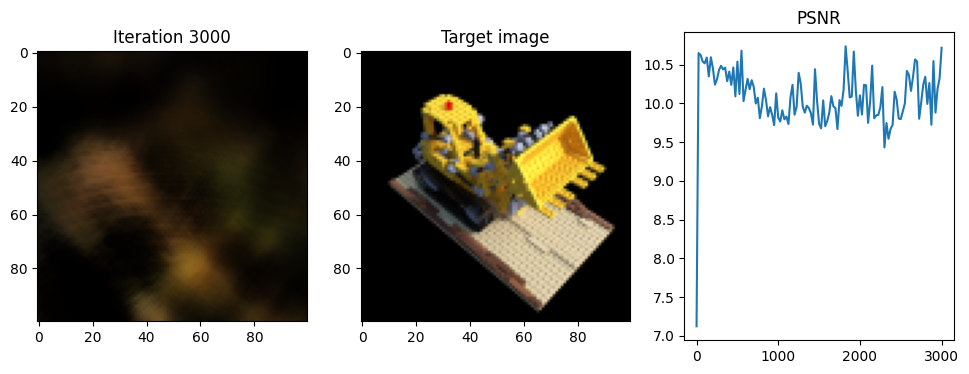

Done!


In [22]:
for i in range(iterations+1):

    
    output_image_idx = np.random.choice(images.shape[0])
    output_image = images[output_image_idx,...]

    w_R_c = w_R_c_all_perturb[output_image_idx,...]
    w_R_c.requires_grad_()
    w_T_c = w_T_c_all[output_image_idx,...]
    
    
    optimizer.zero_grad()
    rec_image = one_forward_pass(height, width, intrinsics, w_R_c, w_T_c, near, far, samples, model, num_x_frequencies, num_d_frequencies)
    w_R_c.retain_grad()
    loss = criterion(rec_image, output_image)
    loss.backward()
    w_R_c_all_perturb[output_image_idx,...] -=  0.1 * w_R_c.grad

    optimizer.step()

    mse_loss_euler = criterion(w_R_c_all, w_R_c_all_perturb)
    running_loss += loss.item()
    psnr = 10 * torch.log10((torch.max(output_image)**2)/loss.item())
    running_psnr += psnr.item()
    running_mse_euler_error += mse_loss_euler.item()

    
    if i % display == 0:
        with torch.no_grad():

            

            test_rec_image = one_forward_pass(height, width, intrinsics, test_pose_w_R_c, test_pose_w_T_c, near, far, samples, model, num_x_frequencies, num_d_frequencies)


            
            loss = criterion(test_rec_image, test_image)
        psnr = 10 * torch.log10((torch.max(test_image)**2)/loss.item())



        print("Iteration %d " % i, "Loss: %.4f " % loss.item(), "PSNR: %.2f " % psnr.item(), \
                "Time: %.2f secs per iter, " % ((time.time() - t) / display), "%.2f mins in total" % ((time.time() - t0)/60))
        if i !=0:
            mse_euler_error_list.append(running_mse_euler_error/display)
            loss_list.append(running_loss/display)
            psnr_list.append(running_psnr/display)
            print('The rotation error as compared to GT Rotation :',running_mse_euler_error/display)
            running_mse_euler_error = 0
            running_loss = 0
            running_psnr = 0
        else:
             print('The rotation error as compared to GT Rotation :',running_mse_euler_error)
        if i%250==0 and i>0 and i<601:
            lr_rotation *= 0.01
        t = time.time()
        psnrs.append(psnr.item())
        iternums.append(i)

        plt.figure(figsize=(16, 4))
        plt.subplot(141)
        plt.imshow(test_rec_image.detach().cpu().numpy())
        plt.title(f"Iteration {i}")
        plt.subplot(142)
        plt.imshow(test_image.detach().cpu().numpy())
        plt.title("Target image")
        plt.subplot(143)
        plt.plot(iternums, psnrs)
        plt.title("PSNR")
        plt.show()

plt.imsave('test_lego-perturb-EulerNoise_RMAdditionGrad-MoreRot-nerf.png',test_rec_image.detach().cpu().numpy())
torch.save(model.state_dict(),'model_Rperturb-EulerNoise_RMAdditionGrad-nerf-MoreRot.pt')
print('Done!')

In [23]:
np.save('perturb-EulerNoise_RMAdditionGrad_loss_list_v1-MoreRot.npy', np.array(loss_list))
np.save('perturb-EulerNoise_RMAdditionGrad_psnr_list_v1-MoreRot.npy', np.array(psnr_list))
np.save('perturb-EulerNoise_RMAdditionGrad_mse_euler_list_v1-MoreRot.npy', np.array(mse_euler_error_list)[1:])

In [24]:
loss_list = np.load('perturb-EulerNoise_RMAdditionGrad_loss_list_v1-MoreRot.npy')
psnr_list = np.load('perturb-EulerNoise_RMAdditionGrad_psnr_list_v1-MoreRot.npy')
mse_euler_error_list = np.load('perturb-EulerNoise_RMAdditionGrad_mse_euler_list_v1-MoreRot.npy')

In [25]:

det_after_train = np.linalg.det(w_R_c_all_perturb.cpu())
print('Mean of the determinants:', det_after_train.mean())
print('Std of the determinants:', det_after_train.std())

Mean of the determinants: 0.99656445
Std of the determinants: 0.004988456


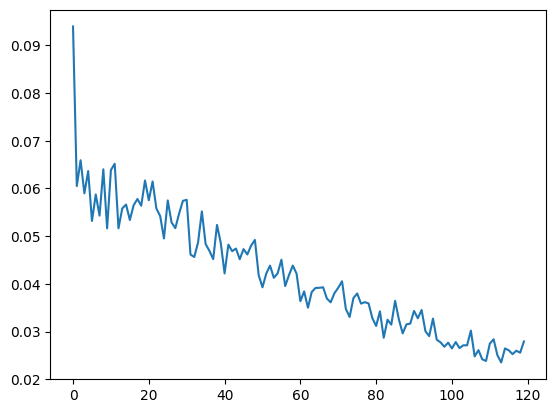

In [26]:
plt.plot(loss_list)

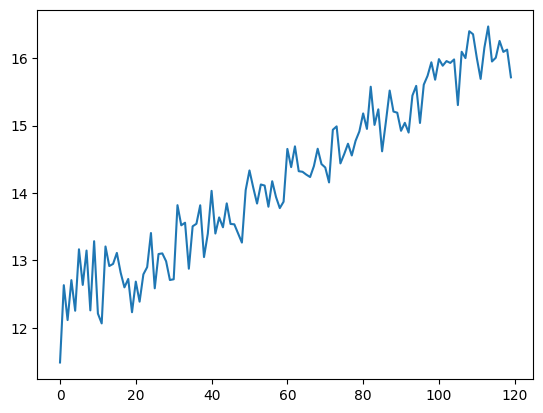

In [27]:
plt.plot(psnr_list)

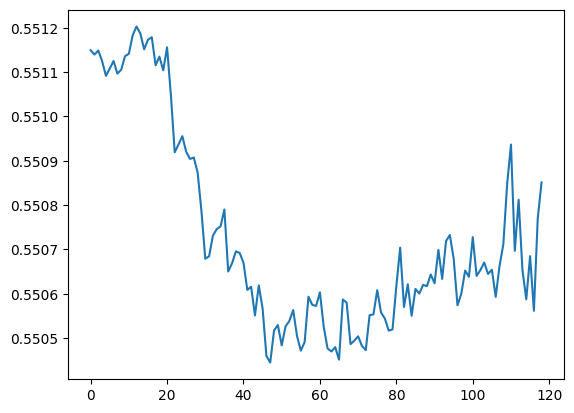

In [28]:
plt.plot(mse_euler_error_list)

In [ ]:
model = nerf_model(num_x_frequencies=num_x_frequencies,num_d_frequencies=num_d_frequencies).to(device)
model.load_state_dict(torch.load('model_Rperturb-EulerNoise_RMAdditionGrad-nerf-MoreRot.pt'))

In [29]:

test_pose_w_R_c = test_pose[:3,:3]
test_pose_w_T_c = test_pose[:3, 3]
lr_rotation=0.1

In [31]:




















test_pose_w_R_c_perturb = rot_d @ test_pose_w_R_c
test_pose_w_R_c, test_pose_w_R_c_perturb.shape,test_pose_w_R_c_perturb

(tensor([[ 6.8935e-01, -5.3373e-01,  4.8982e-01],
         [-7.2443e-01, -5.0789e-01,  4.6611e-01],
         [ 1.4901e-08, -6.7615e-01, -7.3676e-01]], device='cuda:0'),
 torch.Size([3, 3]),
 tensor([[ 0.4955,  0.0924, -0.8637],
         [-0.2358, -0.9427, -0.2361],
         [-0.8360,  0.3207, -0.4453]], device='cuda:0'))

In [32]:
import copy

In [33]:

mse_list = []
running_mse = 0
for test_itr in range(1500):
    test_input = copy.deepcopy(test_pose_w_R_c_perturb)
    test_input.requires_grad_()
    

    rec_image = one_forward_pass(height, width, intrinsics, test_input.to(device), test_pose_w_T_c.to(device), near, far, samples, model, num_x_frequencies, num_d_frequencies)
    loss = criterion(rec_image, test_image)
    loss.backward()
    test_pose_w_R_c_perturb = test_pose_w_R_c_perturb - lr_rotation * test_input.grad.detach()
 
    mse = criterion(test_pose_w_R_c_perturb.to('cpu'),test_pose_w_R_c.to('cpu')).detach().item()
    running_mse += mse
    if test_itr%25==0:
        print('Test image MSE is:', mse)
        mse_list.append(running_mse/25)
        running_mse = 0
    if test_itr%250==0 and test_itr>0 and test_itr<601:
            lr_rotation *= 0.01

Test image MSE is: 0.5565826892852783
Test image MSE is: 0.6048941612243652
Test image MSE is: 0.598692774772644
Test image MSE is: 0.5963449478149414
Test image MSE is: 0.5961202383041382
Test image MSE is: 0.5977171659469604
Test image MSE is: 0.6008111238479614
Test image MSE is: 0.6032220125198364
Test image MSE is: 0.6071515679359436
Test image MSE is: 0.6111646890640259
Test image MSE is: 0.6162935495376587
Test image MSE is: 0.6164015531539917
Test image MSE is: 0.6164920330047607
Test image MSE is: 0.616570234298706
Test image MSE is: 0.6166455149650574
Test image MSE is: 0.6167182922363281
Test image MSE is: 0.6167895197868347
Test image MSE is: 0.6168588399887085
Test image MSE is: 0.6169290542602539
Test image MSE is: 0.616991400718689
Test image MSE is: 0.6170578598976135
Test image MSE is: 0.6170584559440613
Test image MSE is: 0.6170589923858643
Test image MSE is: 0.6170594692230225
Test image MSE is: 0.6170599460601807
Test image MSE is: 0.6170605421066284
Test image MSE 

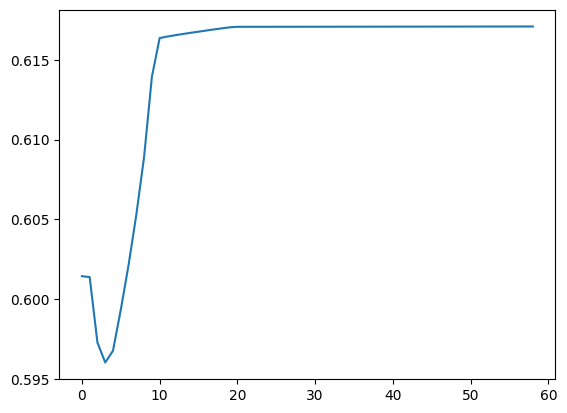

In [34]:
plt.plot(mse_list[1:])

In [35]:
np.save('testpose_perturb-EulerNoise_RMAdditionGrad_mse_euler_list_v1-MoreRot.npy', np.array(mse_list))

In [37]:

np.linalg.det(test_pose_w_R_c_perturb.cpu())

0.8327293